In [1]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
from sklearn.linear_model import Lasso
from scipy.io import loadmat
from sklearn.metrics import mean_squared_error
from scipy.integrate import solve_ivp

import pysindy as ps

import os

import math  

# Ignore matplotlib deprecation warnings
import warnings
warnings.filterwarnings("ignore", category=UserWarning)


from my_function import miscore,siscore
# Seed the random number generators for reproducibility
np.random.seed(100)

integrator_keywords = {}
integrator_keywords['rtol'] = 1e-12
integrator_keywords['method'] = 'LSODA'
integrator_keywords['atol'] = 1e-12

addp=3
startp=80
endp=120
dp=endp-startp
p_tot=addp*(dp-1)+1

In [2]:
'''
def miscore(predtmp,oritmp):
    score=1
    n=1
    sh=predtmp.shape
    if sh!=oritmp.shape:
        print('len not match')
        return 1
    for i in range(len(sh)-1):
        n=n*sh[i]
    pred=predtmp.reshape(n,2)
    ori=oritmp.reshape(n,2)
    n=0
    for i in range(len(pred)):
        if ori[i,0]!=0 or ori[i,1]!=0:
            n=n+1
    #print(n)
    tmp=0
    tmpn=0.0
    for i in range(len(pred)):
        if ori[i,0]!=0 or ori[i,1]!=0:
            tmp=abs((math.sqrt(pred[i,0]*pred[i,0]+pred[i,1]*pred[i,1])-math.sqrt(ori[i,0]*ori[i,0]+ori[i,1]*ori[i,1]))/(math.sqrt(pred[i,0]*pred[i,0]+pred[i,1]*pred[i,1])+math.sqrt(ori[i,0]*ori[i,0]+ori[i,1]*ori[i,1])))
            #print(abs(pred[i]-ori[i])/abs(ori[i]))
            score=score-tmp/n
            if tmp<0.2:
                tmpn=tmpn+1
    print('MI(average/percent):')
    print(score,tmpn/n)
    return score,tmpn/n
    '''

"\ndef miscore(predtmp,oritmp):\n    score=1\n    n=1\n    sh=predtmp.shape\n    if sh!=oritmp.shape:\n        print('len not match')\n        return 1\n    for i in range(len(sh)-1):\n        n=n*sh[i]\n    pred=predtmp.reshape(n,2)\n    ori=oritmp.reshape(n,2)\n    n=0\n    for i in range(len(pred)):\n        if ori[i,0]!=0 or ori[i,1]!=0:\n            n=n+1\n    #print(n)\n    tmp=0\n    tmpn=0.0\n    for i in range(len(pred)):\n        if ori[i,0]!=0 or ori[i,1]!=0:\n            tmp=abs((math.sqrt(pred[i,0]*pred[i,0]+pred[i,1]*pred[i,1])-math.sqrt(ori[i,0]*ori[i,0]+ori[i,1]*ori[i,1]))/(math.sqrt(pred[i,0]*pred[i,0]+pred[i,1]*pred[i,1])+math.sqrt(ori[i,0]*ori[i,0]+ori[i,1]*ori[i,1])))\n            #print(abs(pred[i]-ori[i])/abs(ori[i]))\n            score=score-tmp/n\n            if tmp<0.2:\n                tmpn=tmpn+1\n    print('MI(average/percent):')\n    print(score,tmpn/n)\n    return score,tmpn/n\n    "

In [3]:
'''
def siscore(predtmp,oritmp):
    score=0
    n=1
    sh=predtmp.shape
    if sh!=oritmp.shape:
        print('len not match')
        return 1
    for i in range(len(sh)-1):
        n=n*sh[i]
    pred=predtmp.reshape(n,2)
    ori=oritmp.reshape(n,2)
    n=0
    for i in range(len(pred)):
        if ori[i,0]!=0 and ori[i,1]!=0:
            n=n+1
    #print(n)
    tmp=0
    tmpn=0.0
    for i in range(len(pred)):
        if ori[i,0]!=0 and ori[i,1]!=0:
            tmp=abs((ori[i,0]*pred[i,0]+ori[i,1]*pred[i,1])/math.sqrt(pred[i,0]*pred[i,0]+pred[i,1]*pred[i,1])/math.sqrt(ori[i,0]*ori[i,0]+ori[i,1]*ori[i,1]))
            score=score+tmp/n
            if tmp>0.8:
                tmpn=tmpn+1
            #print(abs(pred[i]-ori[i])/abs(ori[i]))
    print('SI(average/percent):')
    print(score,tmpn/n)

    return score,tmpn/n
    '''

"\ndef siscore(predtmp,oritmp):\n    score=0\n    n=1\n    sh=predtmp.shape\n    if sh!=oritmp.shape:\n        print('len not match')\n        return 1\n    for i in range(len(sh)-1):\n        n=n*sh[i]\n    pred=predtmp.reshape(n,2)\n    ori=oritmp.reshape(n,2)\n    n=0\n    for i in range(len(pred)):\n        if ori[i,0]!=0 and ori[i,1]!=0:\n            n=n+1\n    #print(n)\n    tmp=0\n    tmpn=0.0\n    for i in range(len(pred)):\n        if ori[i,0]!=0 and ori[i,1]!=0:\n            tmp=abs((ori[i,0]*pred[i,0]+ori[i,1]*pred[i,1])/math.sqrt(pred[i,0]*pred[i,0]+pred[i,1]*pred[i,1])/math.sqrt(ori[i,0]*ori[i,0]+ori[i,1]*ori[i,1]))\n            score=score+tmp/n\n            if tmp>0.8:\n                tmpn=tmpn+1\n            #print(abs(pred[i]-ori[i])/abs(ori[i]))\n    print('SI(average/percent):')\n    print(score,tmpn/n)\n\n    return score,tmpn/n\n    "

In [4]:

file_path = os.path.join('D:\\', 'hotaidata','sr_C6_01')
x=[]
y=[]
vx=[]
vy=[]
isvalid=[]
xtmp=[]
ytmp=[]
vxtmp=[]
vytmp=[]
isvalidtmp=[]
for root,dirs,files in os.walk(file_path):
    #print(root)
    
    for dir in dirs:
        #print(os.path.join(root,file))

            with open(os.path.join(root,dir,'B00001.dat'), 'r') as f:  
                lines = f.readlines()
                for line in lines[3:]: 
                    num=line.split()
                    xtmp.append(float(num[0]))
                    ytmp.append(float(num[1]))
                    vxtmp.append(float(num[2]))
                    vytmp.append(float(num[3]))
                    isvalidtmp.append(float(num[4]))

            x.append(np.array(xtmp).reshape(25,25))
            y.append(np.array(ytmp).reshape(25,25))
            vx.append(np.array(vxtmp).reshape(25,25))
            vy.append(np.array(vytmp).reshape(25,25))
            isvalid.append(np.array(isvalidtmp).reshape(25,25))
            xtmp=[]
            ytmp=[]
            vxtmp=[]
            vytmp=[]
            isvalidtmp=[]
#
x=np.array(x)
y=np.array(y)
vx=np.array(vx)
vy=np.array(vy)
isvalid=np.array(isvalid)

x=x.T
y=y.T
vx=vx.T
vy=vy.T
#print(x[0,:,:])
t=np.linspace(0,60/800,121)
dt=0.00002

t=t[startp:endp]
print(len(t))
t_train=np.linspace(t[0],t[-1],addp*(len(t)-1)+1)
dt_train=t_train[1]-t_train[0]
print(len(t_train.shape))
si_t=np.zeros(p_tot)
mi_t=np.zeros(p_tot)
si_t_per=np.zeros(p_tot)
mi_t_per=np.zeros(p_tot)

40
1


In [5]:
#u is not pre adding, v add a median
spatial_grid = np.asarray([x[:,:,0].T,y[:,:,0].T]).T

n=25

u=np.zeros((n,n,121, 2))

u[:, :, :, 0] = vx
u[:, :, :, 1] = vy
u_train=np.zeros((n,n,len(t), 2))

u_train=u[:,:,startp:endp,:]

v_train=np.zeros((n,n,len(t_train),2))

for i in range(len(t)-1):
    for j in range(addp):
        v_train[:,:,addp*i+j]=(u_train[:,:,i]*(addp-j)+u_train[:,:,i+1]*j)/addp
v_train[:,:,-1]=u_train[:,:,-1]


In [6]:
v_train_dot = ps.FiniteDifference(axis=2)._differentiate(v_train, dt_train)

vtmp=np.zeros(v_train_dot.shape)
vtmp[:,:,0]=v_train[:,:,0]
for i in range(len(t_train)-1):
    vtmp[:,:,i+1]=vtmp[:,:,i]+v_train_dot[:,:,i]*dt_train
miscore(vtmp,v_train)

vtmp=v_train+v_train_dot*dt_train

vtmp[:,:,1:]=vtmp[:,:,:len(t_train)-1]
miscore(vtmp,v_train)
siscore(vtmp,v_train)


MI(average/percent):
0.9561614229903838 0.9824911771947583
MI(average/percent):
0.9847422744467685 0.9922578174158072
SI(average/percent):
0.9960968805885569 0.9964982354389517


(0.9960968805885569, 0.9964982354389517)

In [7]:
# Define PDE library that is quadratic in u, and
# fourth-order in spatial derivatives of u.    

library_functions = [
    lambda y: y,
    lambda x: x,

    lambda x, y: x * y * y,
    lambda x, y: x * x * y,
]
library_function_names = [
    lambda y: y,
    lambda x: x,

    lambda x, y: x + y + y,
    lambda x, y: x + x + y,
]
pde_lib = ps.PDELibrary(
    library_functions=library_functions,
    function_names=library_function_names,
    derivative_order=1,
    spatial_grid=spatial_grid,
    include_bias=True,
    is_uniform=True,
    periodic=True
)


# Again, loop through all the optimizers
#print('STLSQ model: ')
print('v_train')
print(v_train.shape)

'''
print('SINDy')
model = ps.SINDy(feature_names=['Vx','Vy'])

model.fit(u_train, x_dot=u_dot_train)
model.print()
u_dot_stlsq = model.predict(u_train)

'''
print('STLSQ model: ')
optimizer = ps.STLSQ(threshold=50, alpha=1e-5, 
                     normalize_columns=True, max_iter=200)
model = ps.SINDy(feature_library=pde_lib, optimizer=optimizer,feature_names=['Vx','Vy'])
model.fit(v_train, dt_train)
model.print()
'''
print('SR3 model, L0 norm: ')
optimizer = ps.SR3(threshold=7, max_iter=10000, tol=1e-15, nu=1e2,
                   thresholder='l0', normalize_columns=True)
model = ps.SINDy(feature_library=pde_lib, optimizer=optimizer,feature_names=['Vx','Vy'])
model.fit(u_train, t=dt)
model.print()


print('SR3 model, L1 norm: ')
optimizer = ps.SR3(threshold=0.05, max_iter=10000, tol=1e-15,
                   thresholder='l1', normalize_columns=True)

model = ps.SINDy(feature_library=pde_lib, optimizer=optimizer)
model.fit(u_train, x_dot=u_dot_train)
model.print()'''

v_train
(25, 25, 118, 2)
STLSQ model: 
(Vx)' = 191.295 1 + 1031383652885.519 Vx + -4373244617662.879 Vy + -1031383652863.601 Vx + 4373244617690.421 Vy + -0.123 VxVyVy + -0.181 VxVxVy + 181.514 Vx_2 + 45.860 Vy_2 + 73.329 Vx_1 + -111.466 Vy_1 + 933372767097.930 VxVx_2 + -2219589642373.662 VxVy_2 + -933372767081.906 VyVx_2 + 2219589642227.254 VyVy_2 + 0.215 VxVx_2 + 0.500 VxVy_2 + 2580964416439.651 VyVx_2 + -4328706922087.552 VyVy_2 + -2580964416353.966 VxVyVyVx_2 + 4328706922092.068 VxVyVyVy_2 + 0.076 VxVxVyVx_2 + -0.024 VxVxVyVy_2 + -1925325226945.371 VxVx_1 + 181625023587.463 VxVy_1 + 1925325226954.971 VyVx_1 + -181625023530.937 VyVy_1 + -0.456 VxVx_1 + -0.227 VxVy_1 + -3770941101608.487 VyVx_1 + 831062539279.300 VyVy_1 + 3770941101613.509 VxVyVyVx_1 + -831062539278.538 VxVyVyVy_1 + -0.044 VxVxVyVx_1 + 0.671 VxVxVyVy_1
(Vy)' = -90.513 1 + -502932764063.811 Vx + 2264258062851.350 Vy + 502932764045.296 Vx + -2264258062858.032 Vy + -0.230 VxVyVy + -0.263 VxVxVy + -50.288 Vx_2 + 114.482 V

"\nprint('SR3 model, L0 norm: ')\noptimizer = ps.SR3(threshold=7, max_iter=10000, tol=1e-15, nu=1e2,\n                   thresholder='l0', normalize_columns=True)\nmodel = ps.SINDy(feature_library=pde_lib, optimizer=optimizer,feature_names=['Vx','Vy'])\nmodel.fit(u_train, t=dt)\nmodel.print()\n\n\nprint('SR3 model, L1 norm: ')\noptimizer = ps.SR3(threshold=0.05, max_iter=10000, tol=1e-15,\n                   thresholder='l1', normalize_columns=True)\n\nmodel = ps.SINDy(feature_library=pde_lib, optimizer=optimizer)\nmodel.fit(u_train, x_dot=u_dot_train)\nmodel.print()"

In [8]:
print("Model score: %f" % model.score(u_train, t=t))
print("Model score: %f" % model.score(u_train, t=dt))
print("Model score: %f" % model.score(v_train, t=t_train))
print("Model score: %f" % model.score(v_train, t=dt_train))

Model score: 0.015151
Model score: -0.003986
Model score: 0.009410
Model score: 0.009410


In [9]:
x_dot_test_predicted = model.predict(v_train)
tlen=len(t_train)
dot_tmp=np.array(x_dot_test_predicted)
pltpredict=np.zeros((n,n,tlen,2))


In [10]:
print('add 7 point, from 80 to 120, with library x^3, derivative order 2, MI:0.6748241001379309, SI:0.8570345301079201')
print('add 7 point, from 80 to 120, with library x^3, derivative order 1, MI:0.6732771082529756, SI:0.8589308511150588')
print('add 7 point, from 80 to 120, with library x^2, derivative order 2, MI:0.6707939885275049, SI:0.8459658232811543')
print('add 7 point, from 80 to 120, with library x^2, derivative order 1, MI:0.6693806511354194, SI:0.8426666431380524')
print('add 7 point, from 90 to 120, with library x^2, derivative order 1, MI:0.6709005447980256, SI:0.8424080789942714')
pltpredict[:,:,0]=v_train[:,:,0]
for i in range(len(t_train)-1):
    pltpredict[:,:,i+1]=pltpredict[:,:,i]+dot_tmp[:,:,i]*dt_train
miscore(pltpredict,v_train)
siscore(pltpredict,v_train)

add 7 point, from 80 to 120, with library x^3, derivative order 2, MI:0.6748241001379309, SI:0.8570345301079201
add 7 point, from 80 to 120, with library x^3, derivative order 1, MI:0.6732771082529756, SI:0.8589308511150588
add 7 point, from 80 to 120, with library x^2, derivative order 2, MI:0.6707939885275049, SI:0.8459658232811543
add 7 point, from 80 to 120, with library x^2, derivative order 1, MI:0.6693806511354194, SI:0.8426666431380524
add 7 point, from 90 to 120, with library x^2, derivative order 1, MI:0.6709005447980256, SI:0.8424080789942714
MI(average/percent):
0.7786304853847916 0.554318386999699
SI(average/percent):
0.863033426715394 0.7904139195141302


(0.863033426715394, 0.7904139195141302)

0


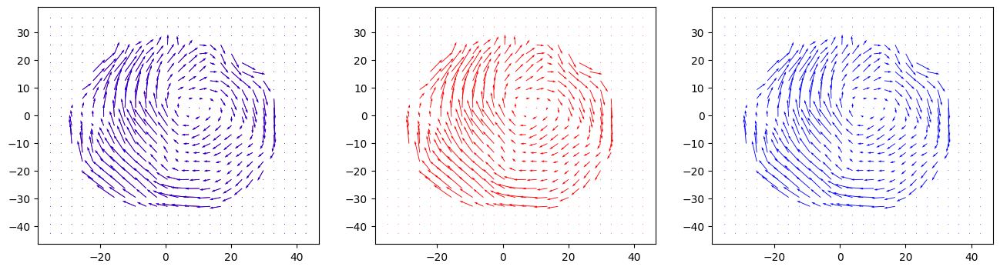

MI(average/percent):
1.0 1.0
SI(average/percent):
0.9999999999999934 1.0
1


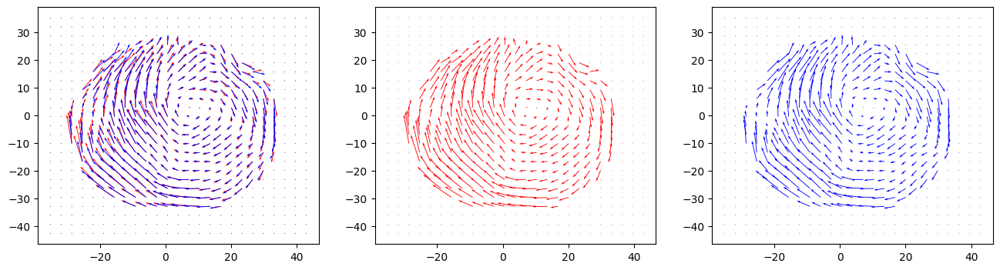

MI(average/percent):
0.9328672656529232 0.9548387096774194
SI(average/percent):
0.9914638400292286 0.9967741935483871
2


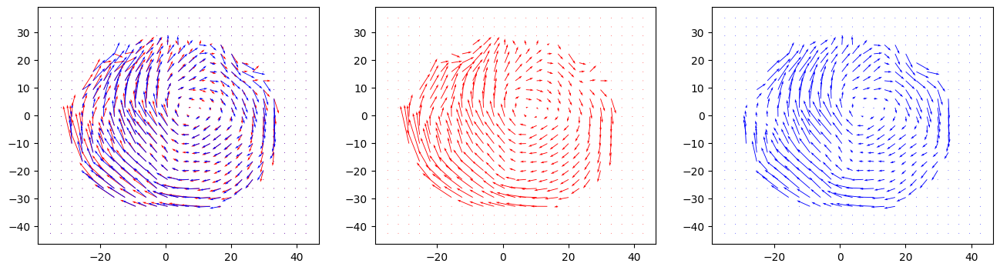

MI(average/percent):
0.8707284806830838 0.7645161290322581
SI(average/percent):
0.9617635875799213 0.964516129032258
3


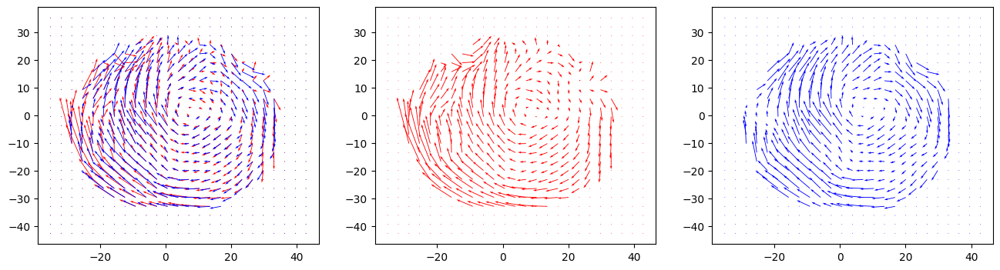

MI(average/percent):
0.8191612406361508 0.6440129449838188
SI(average/percent):
0.9193961022907683 0.889967637540453
4


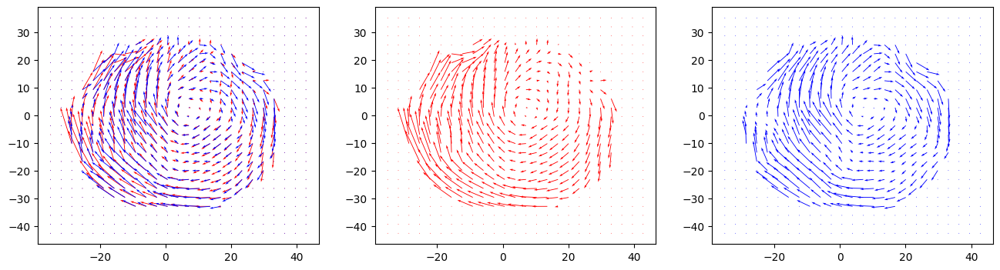

MI(average/percent):
0.8303303702760797 0.6741935483870968
SI(average/percent):
0.9369353900733232 0.9290322580645162
5


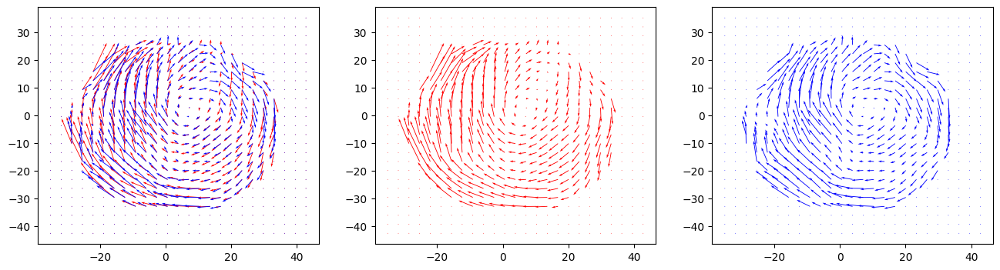

MI(average/percent):
0.8306662491582365 0.667741935483871
SI(average/percent):
0.9245044681550199 0.8903225806451613
6


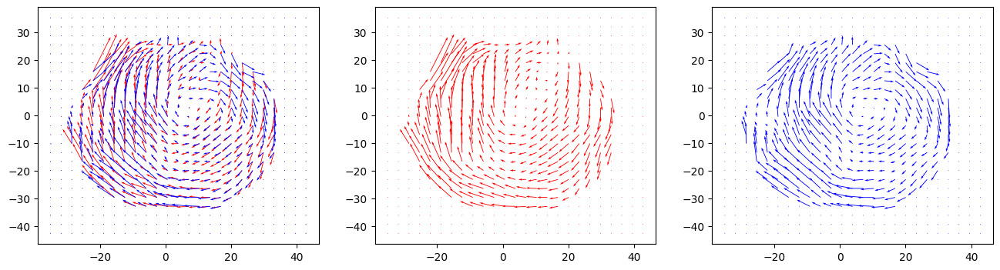

MI(average/percent):
0.8180165894341901 0.6258064516129033
SI(average/percent):
0.8987860020001499 0.8580645161290322
7


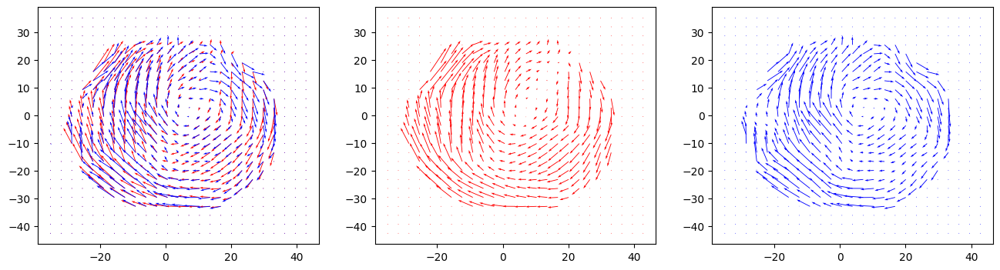

MI(average/percent):
0.8220138493687594 0.632258064516129
SI(average/percent):
0.91611738669721 0.8903225806451613
8


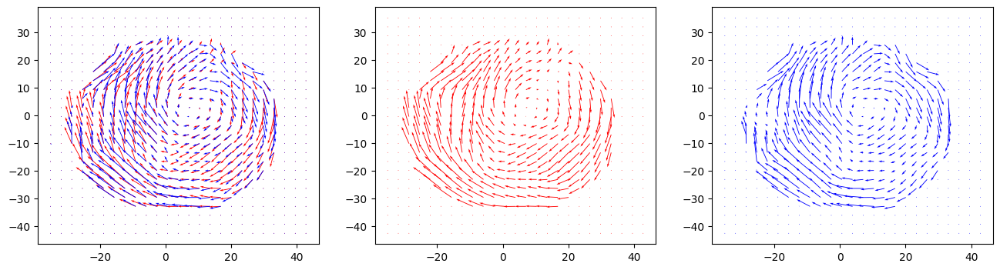

MI(average/percent):
0.8121701288096247 0.6483870967741936
SI(average/percent):
0.9308473154613887 0.9258064516129032
9


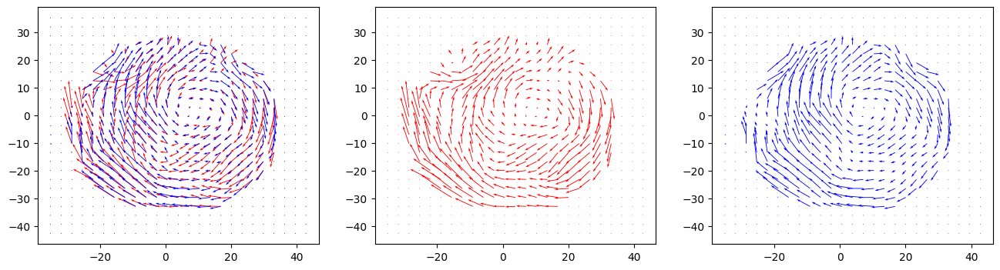

MI(average/percent):
0.7879625640416071 0.5533980582524272
SI(average/percent):
0.9049973834097178 0.883495145631068
10


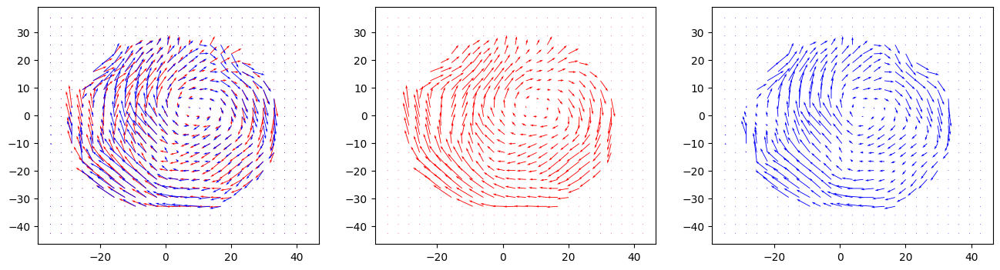

MI(average/percent):
0.8373799319690146 0.6893203883495146
SI(average/percent):
0.9303232918357 0.9288025889967637
11


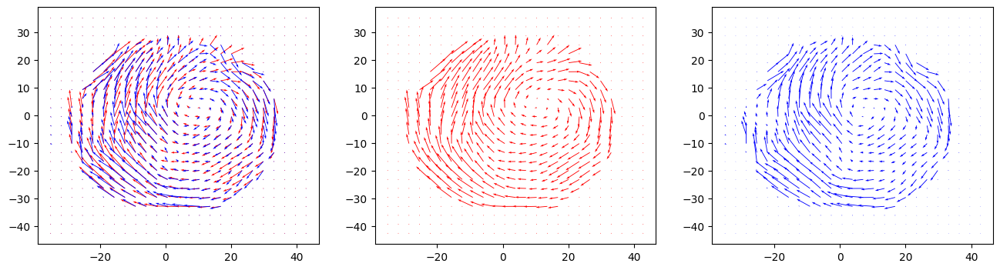

MI(average/percent):
0.8640861544413323 0.8025889967637541
SI(average/percent):
0.9326210208851353 0.9255663430420712
12


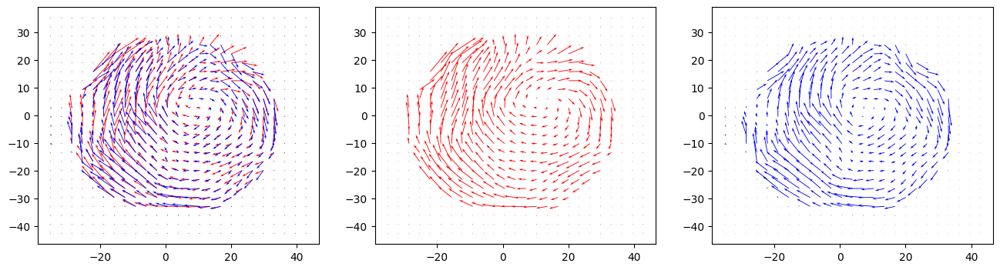

MI(average/percent):
0.8573423059587053 0.7702265372168284
SI(average/percent):
0.9203640703215334 0.8996763754045307
13


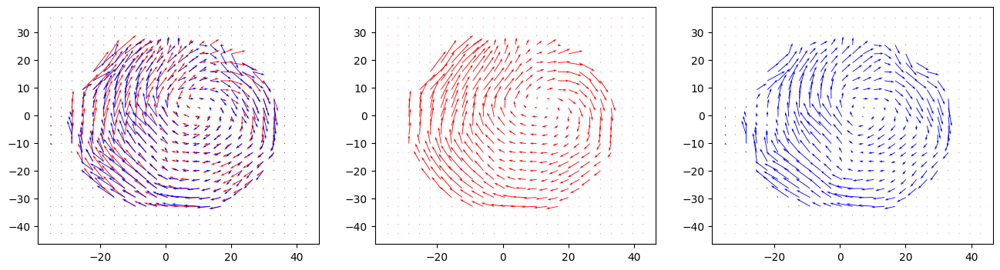

MI(average/percent):
0.8585487213753543 0.7774193548387097
SI(average/percent):
0.9370243314971105 0.9290322580645162
14


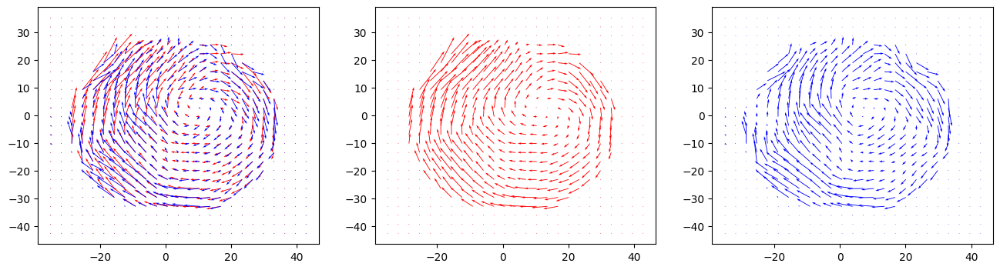

MI(average/percent):
0.8383392961350282 0.7129032258064516
SI(average/percent):
0.9408444480065156 0.9354838709677419
15


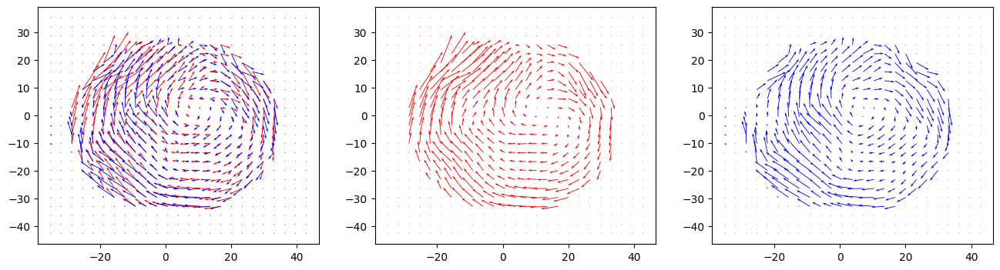

MI(average/percent):
0.8159240969659803 0.635483870967742
SI(average/percent):
0.92222358100435 0.9096774193548387
16


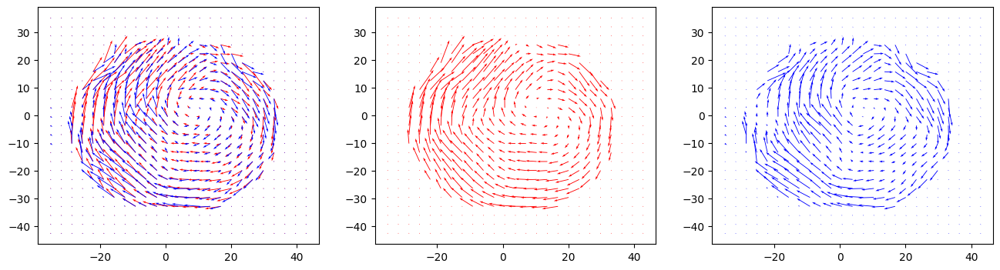

MI(average/percent):
0.8207377472661429 0.6483870967741936
SI(average/percent):
0.9342065212252275 0.9225806451612903
17


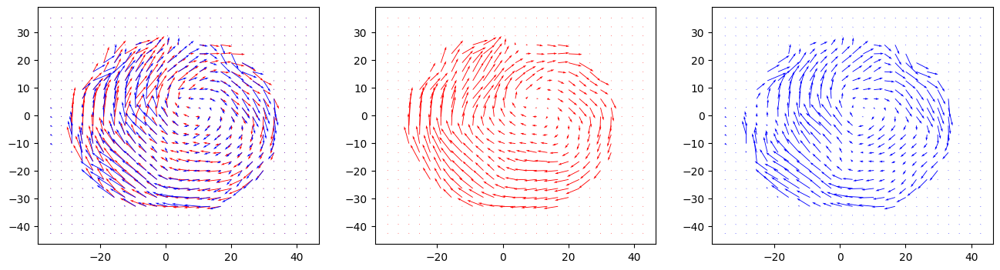

MI(average/percent):
0.8144920389617099 0.6483870967741936
SI(average/percent):
0.935953536032526 0.9193548387096774
18


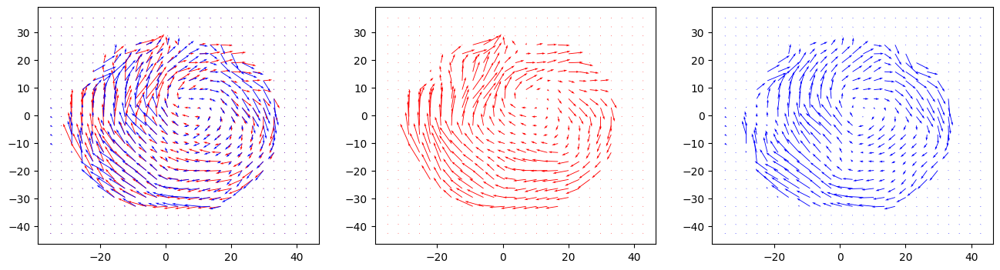

MI(average/percent):
0.7946219868317687 0.5806451612903226
SI(average/percent):
0.9087385732393293 0.8612903225806452
19


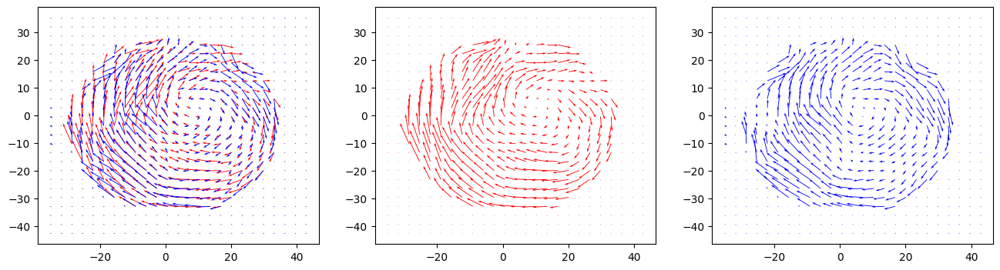

MI(average/percent):
0.804627946825367 0.5741935483870968
SI(average/percent):
0.9136093301761516 0.8548387096774194
20


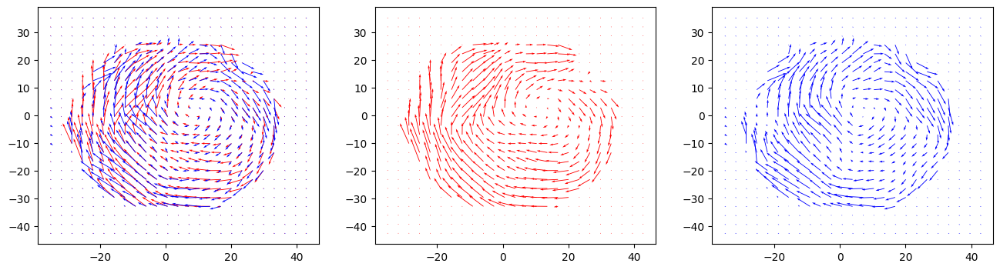

MI(average/percent):
0.8041813086586136 0.5903225806451613
SI(average/percent):
0.8943186799878905 0.8161290322580645
21


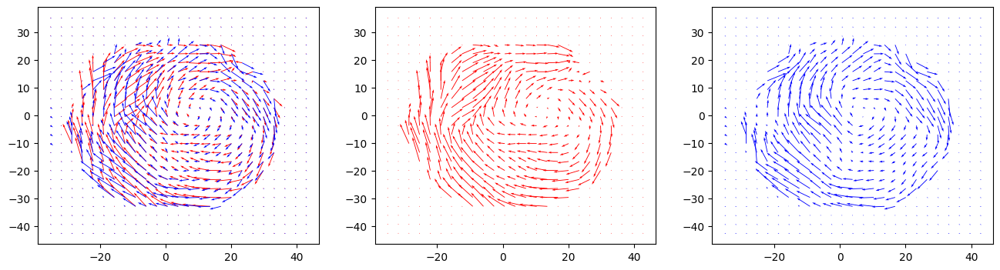

MI(average/percent):
0.8076998469809632 0.5954692556634305
SI(average/percent):
0.8596527689987319 0.7831715210355987
22


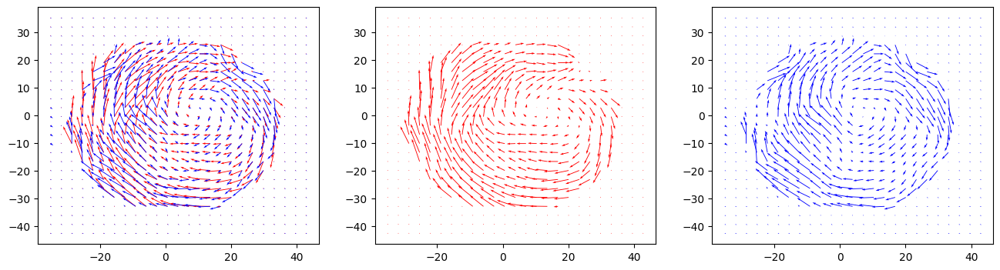

MI(average/percent):
0.8069453711521088 0.6225806451612903
SI(average/percent):
0.8793701165978132 0.8064516129032258
23


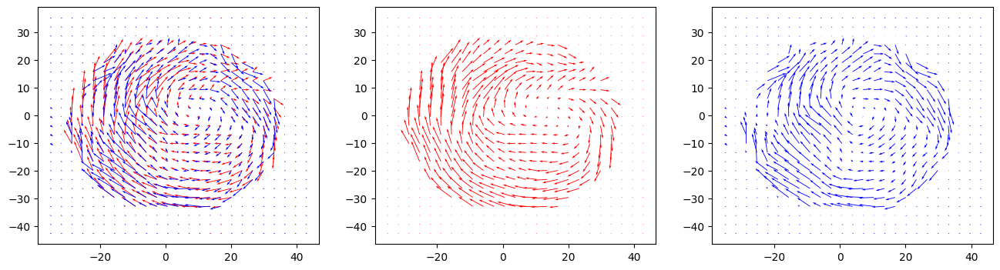

MI(average/percent):
0.8045841820427777 0.5935483870967742
SI(average/percent):
0.8839093374908183 0.7935483870967742
24


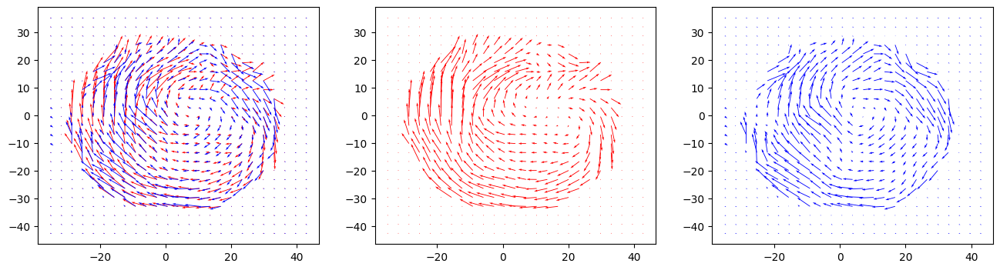

MI(average/percent):
0.7904365100435818 0.5612903225806452
SI(average/percent):
0.8701418525031276 0.8064516129032258
25


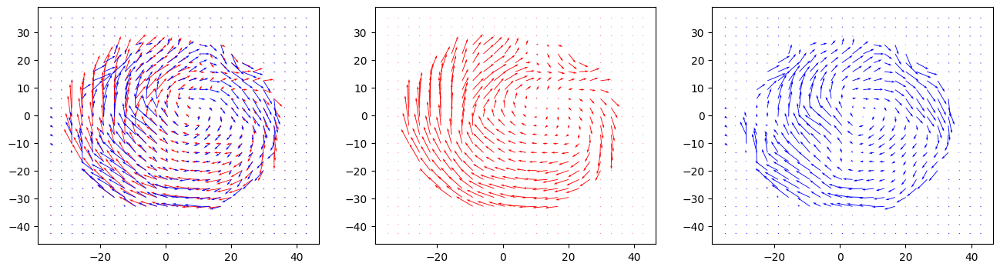

MI(average/percent):
0.7776800379883254 0.5612903225806452
SI(average/percent):
0.8938574940291822 0.8193548387096774
26


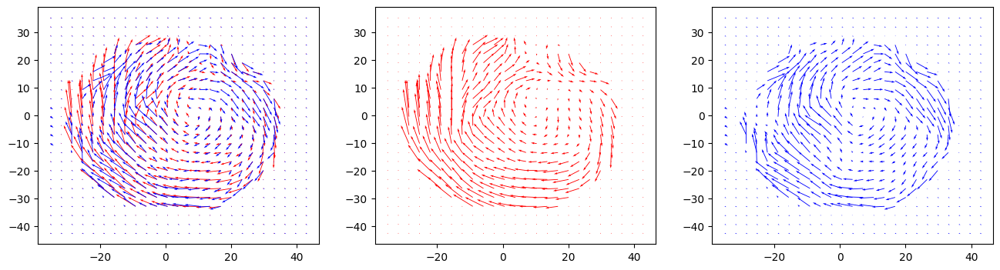

MI(average/percent):
0.7694625625216212 0.5709677419354838
SI(average/percent):
0.8908300200430398 0.8290322580645161
27


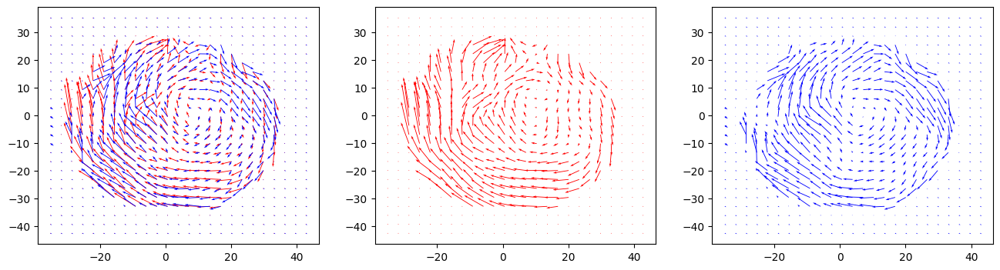

MI(average/percent):
0.773635563509869 0.5533980582524272
SI(average/percent):
0.8610097124632288 0.7637540453074434
28


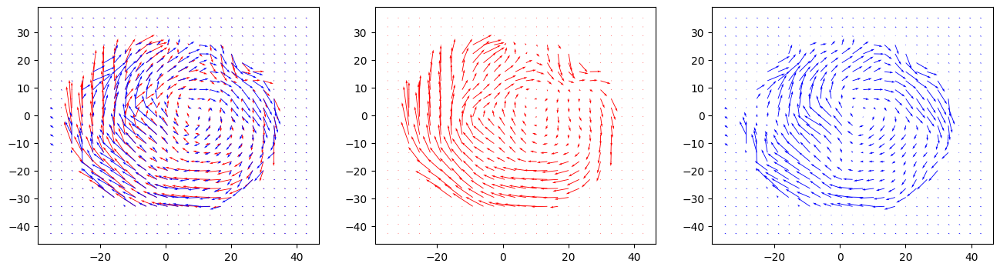

MI(average/percent):
0.7682700670737718 0.535483870967742
SI(average/percent):
0.8845702701257357 0.8032258064516129
29


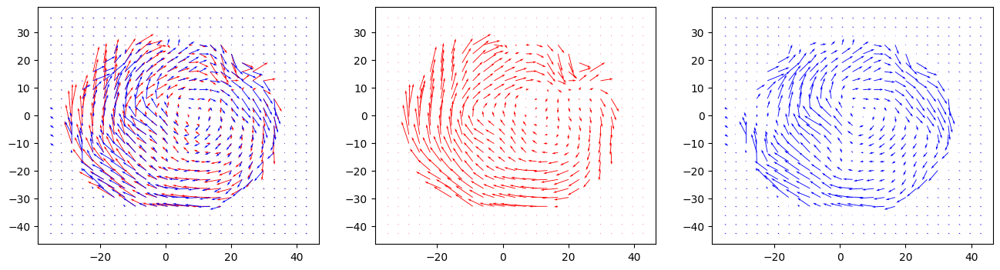

MI(average/percent):
0.7732610312775239 0.5548387096774193
SI(average/percent):
0.8835322618201301 0.8129032258064516
30


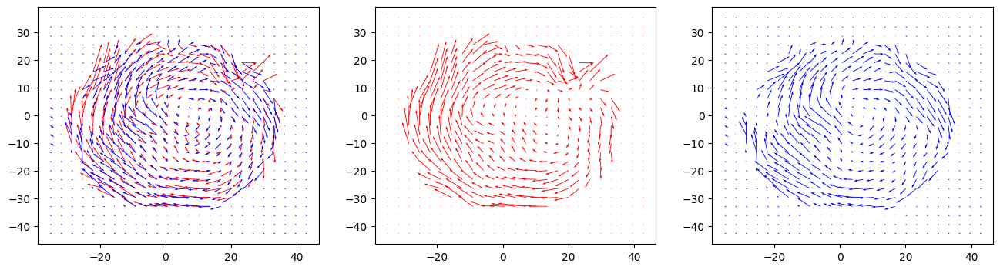

MI(average/percent):
0.7793236365768782 0.598705501618123
SI(average/percent):
0.86245324112528 0.8025889967637541
31


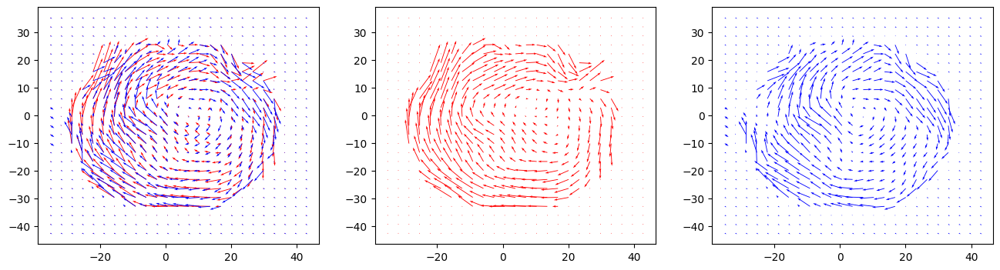

MI(average/percent):
0.7966122744000949 0.5903225806451613
SI(average/percent):
0.8753298158932634 0.8290322580645161
32


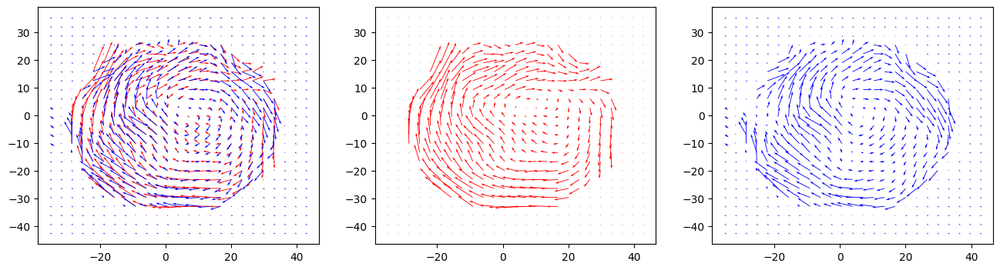

MI(average/percent):
0.8090430413372858 0.6129032258064516
SI(average/percent):
0.87522955658702 0.8129032258064516
33


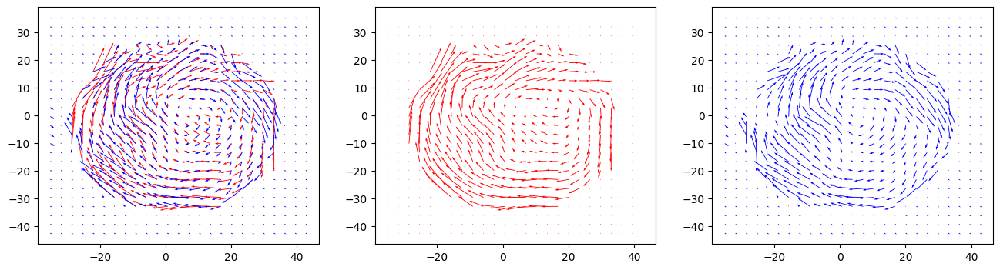

MI(average/percent):
0.810738987855297 0.5806451612903226
SI(average/percent):
0.8656296005175702 0.7580645161290323
34


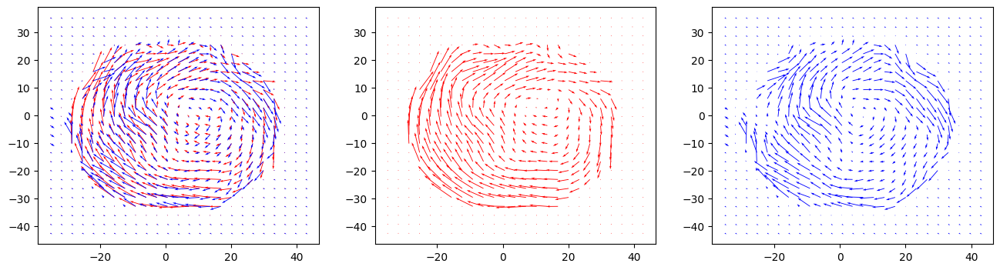

MI(average/percent):
0.8052157657168407 0.5967741935483871
SI(average/percent):
0.8884048364335162 0.832258064516129
35


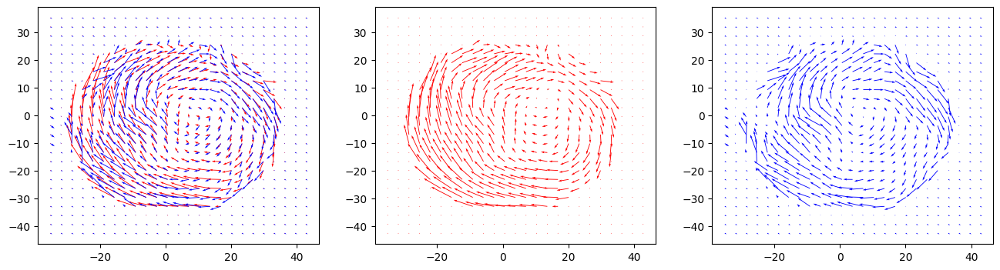

MI(average/percent):
0.7939588613071293 0.5516129032258065
SI(average/percent):
0.8890149423021384 0.8354838709677419
36


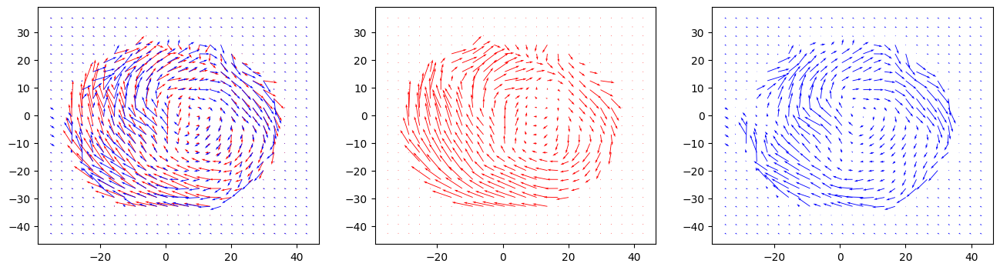

MI(average/percent):
0.7858775330052893 0.5487012987012987
SI(average/percent):
0.8697274861217631 0.7824675324675324
37


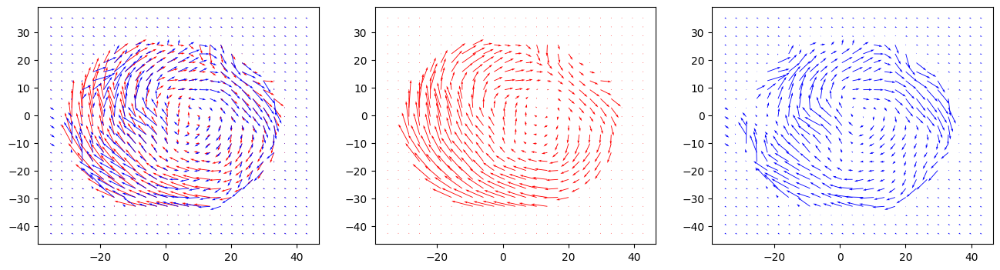

MI(average/percent):
0.7752266150128035 0.5145631067961165
SI(average/percent):
0.896402217395253 0.8511326860841424
38


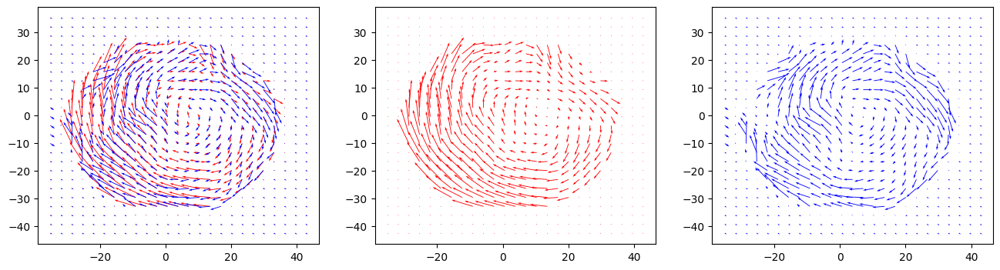

MI(average/percent):
0.7529726405629418 0.47896440129449835
SI(average/percent):
0.9092684589830183 0.8705501618122977
39


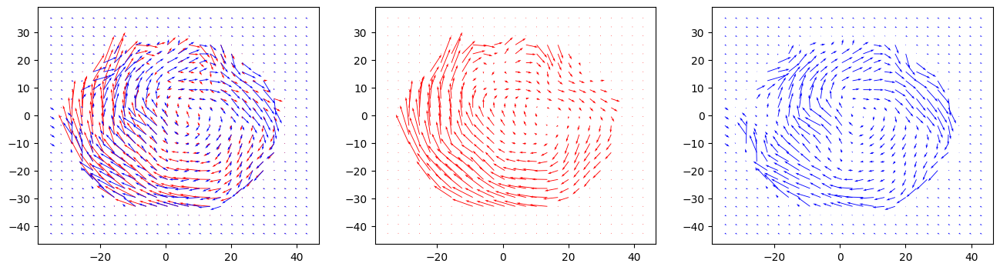

MI(average/percent):
0.7256111679236809 0.42394822006472493
SI(average/percent):
0.8859866683016887 0.8252427184466019
40


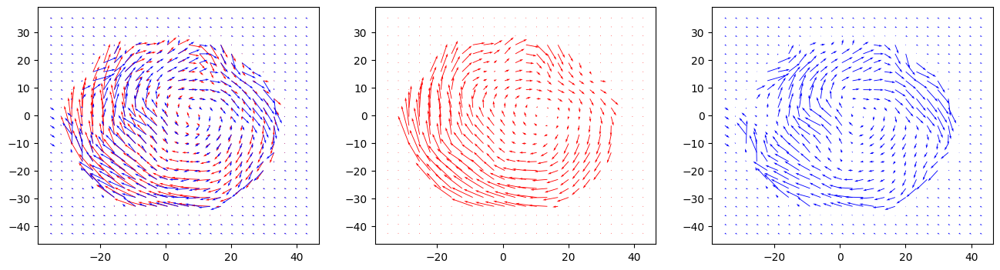

MI(average/percent):
0.7596659595518237 0.49032258064516127
SI(average/percent):
0.9103577532917152 0.8870967741935484
41


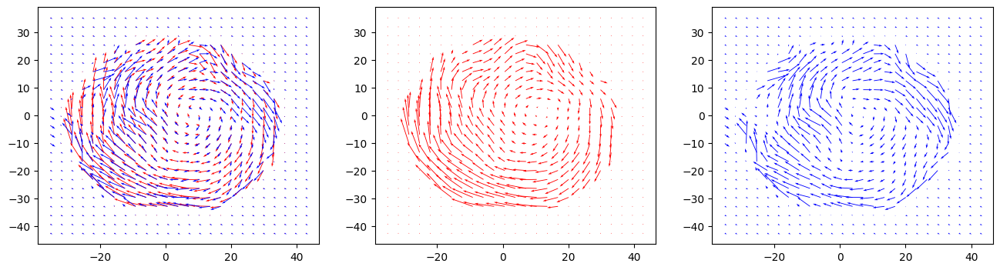

MI(average/percent):
0.7889746668950699 0.5290322580645161
SI(average/percent):
0.9104523352650696 0.8580645161290322
42


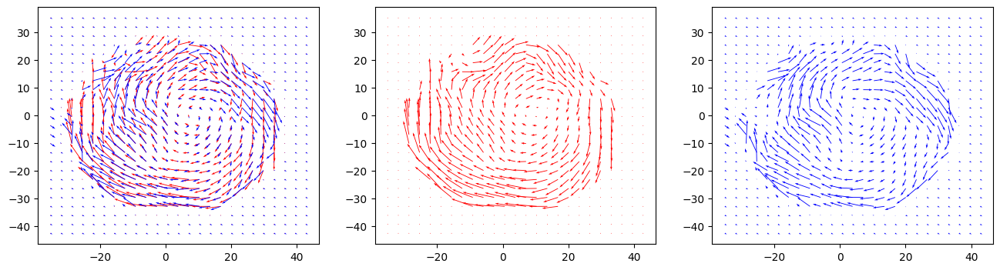

MI(average/percent):
0.800998143964073 0.5838709677419355
SI(average/percent):
0.8897627820317495 0.8225806451612904
43


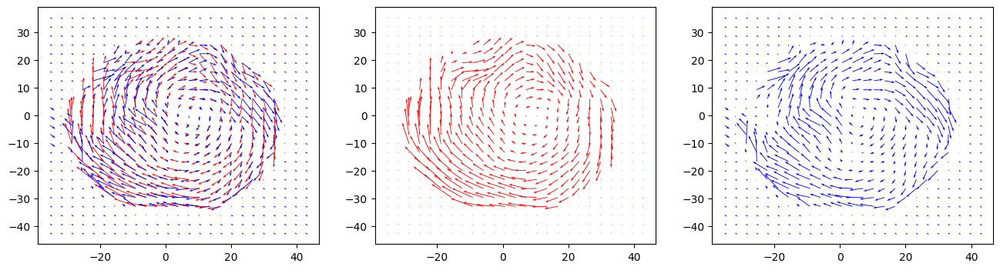

MI(average/percent):
0.8183624228948703 0.635483870967742
SI(average/percent):
0.9029242338367459 0.8419354838709677
44


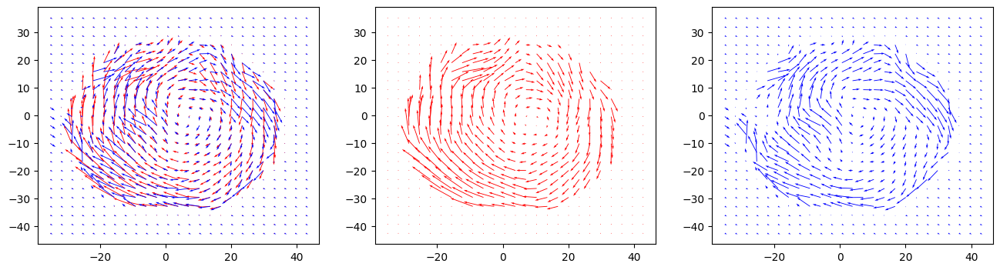

MI(average/percent):
0.8202550316906085 0.6516129032258065
SI(average/percent):
0.8945271944375028 0.8483870967741935
45


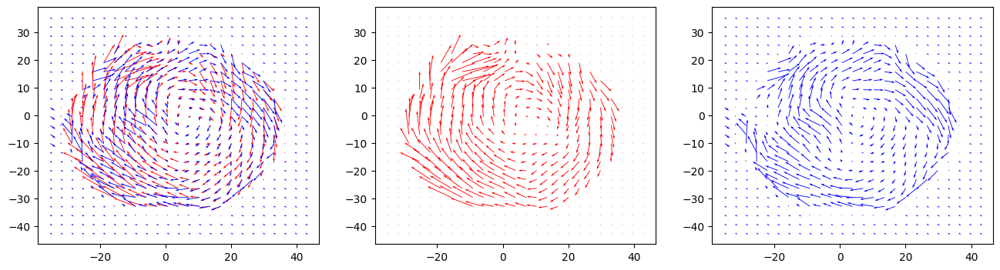

MI(average/percent):
0.8047716028467394 0.6440129449838188
SI(average/percent):
0.866547998732461 0.7766990291262136
46


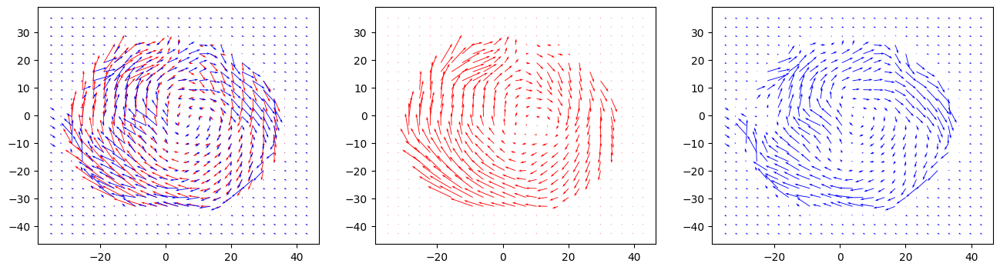

MI(average/percent):
0.8043961564852475 0.6258064516129033
SI(average/percent):
0.8800174512633273 0.8064516129032258
47


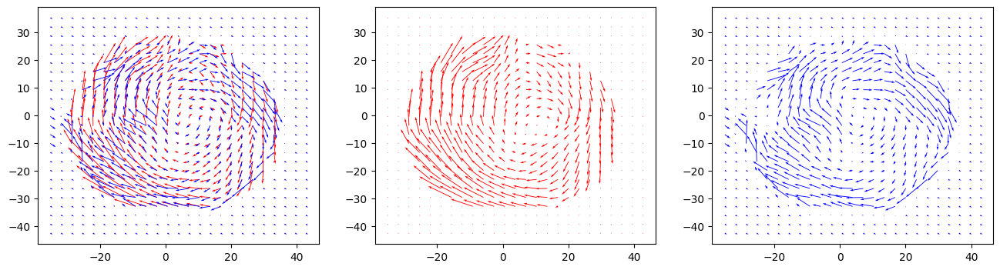

MI(average/percent):
0.7984245185744486 0.6096774193548387
SI(average/percent):
0.874108660178574 0.7903225806451613
48


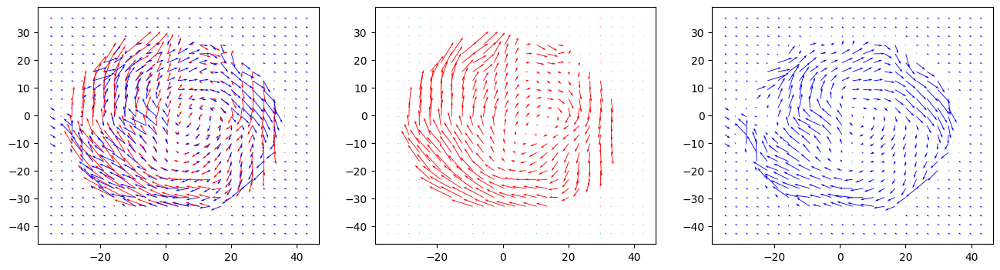

MI(average/percent):
0.7919144072455918 0.6019417475728155
SI(average/percent):
0.8551666256764552 0.7540453074433657
49


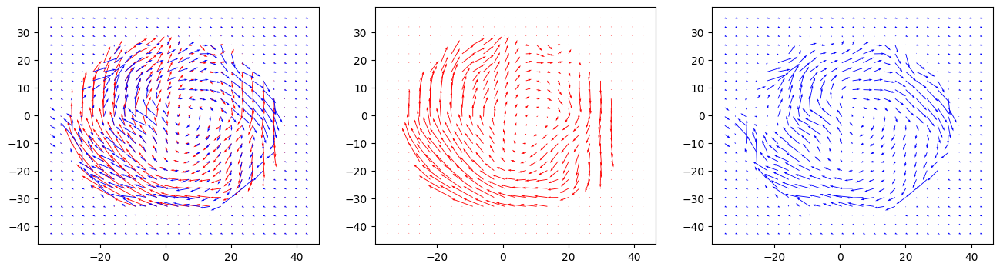

MI(average/percent):
0.792437059972614 0.5825242718446602
SI(average/percent):
0.8641338895468835 0.7572815533980582
50


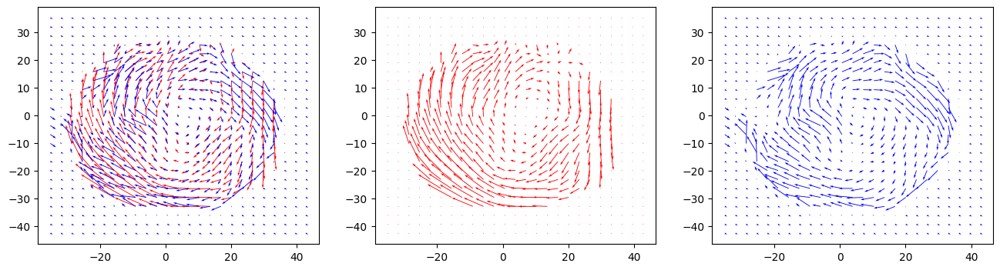

MI(average/percent):
0.7827228870844074 0.5857605177993528
SI(average/percent):
0.8660614532168766 0.7669902912621359
51


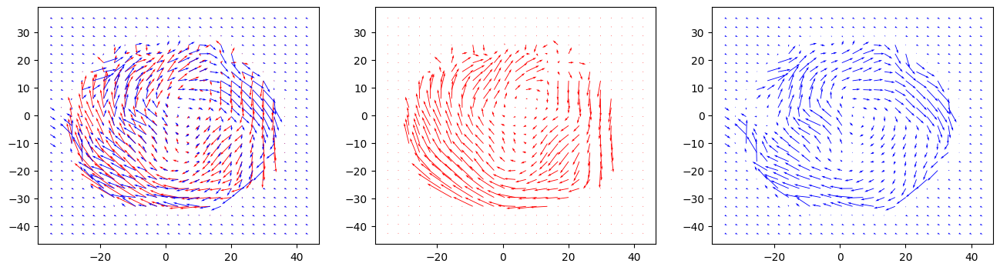

MI(average/percent):
0.7838703669882657 0.5889967637540453
SI(average/percent):
0.830756694446116 0.7119741100323624
52


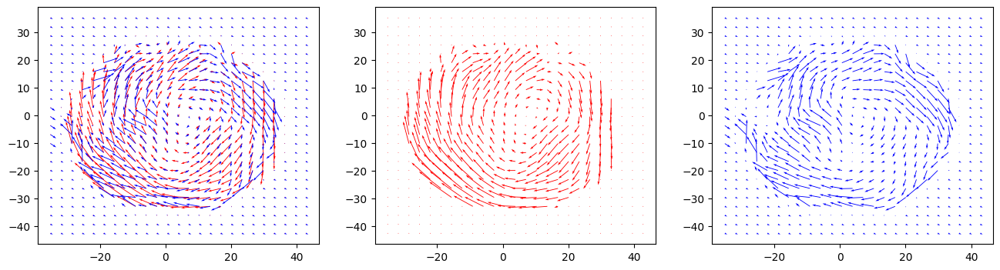

MI(average/percent):
0.77790150601163 0.567741935483871
SI(average/percent):
0.8617567051169226 0.7935483870967742
53


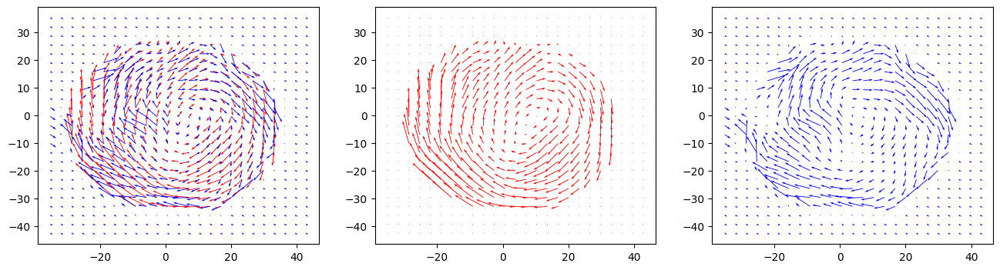

MI(average/percent):
0.7929472020649264 0.5774193548387097
SI(average/percent):
0.8738077341847831 0.7967741935483871
54


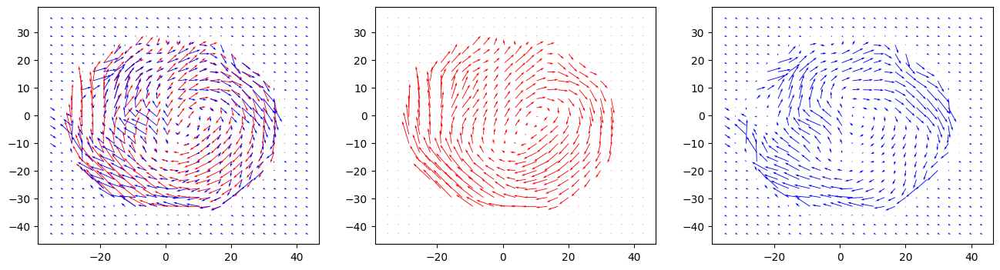

MI(average/percent):
0.8012994506062859 0.6181229773462783
SI(average/percent):
0.85457194678664 0.7702265372168284
55


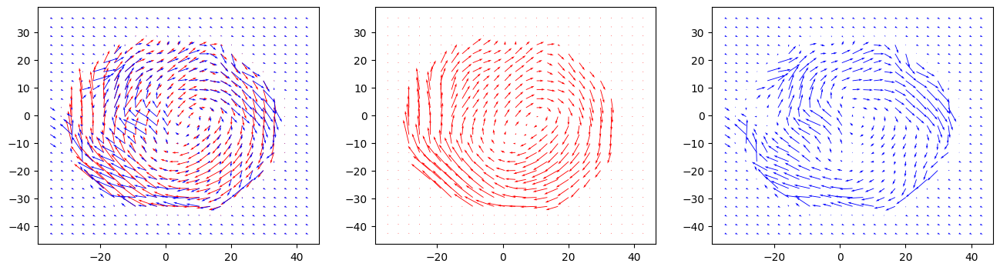

MI(average/percent):
0.784874813522857 0.5387096774193548
SI(average/percent):
0.8656174776457083 0.7903225806451613
56


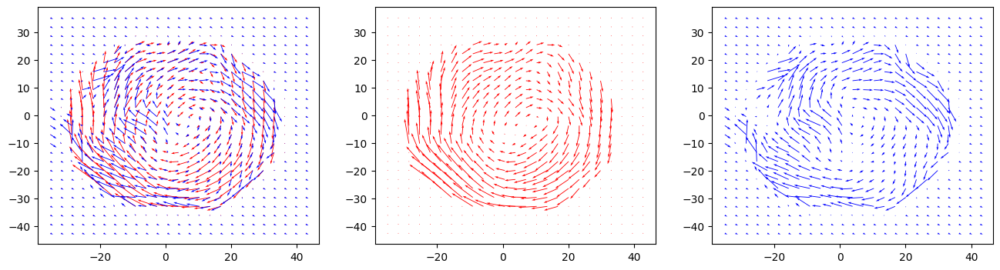

MI(average/percent):
0.7700913422964637 0.5
SI(average/percent):
0.8572266946379649 0.7806451612903226
57


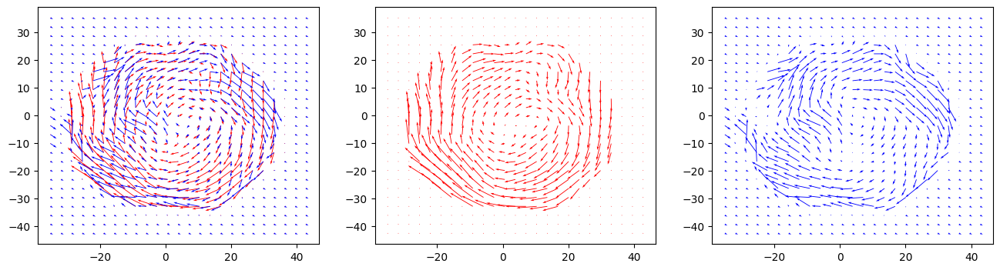

MI(average/percent):
0.76808707924781 0.5064516129032258
SI(average/percent):
0.8230292283453632 0.7322580645161291
58


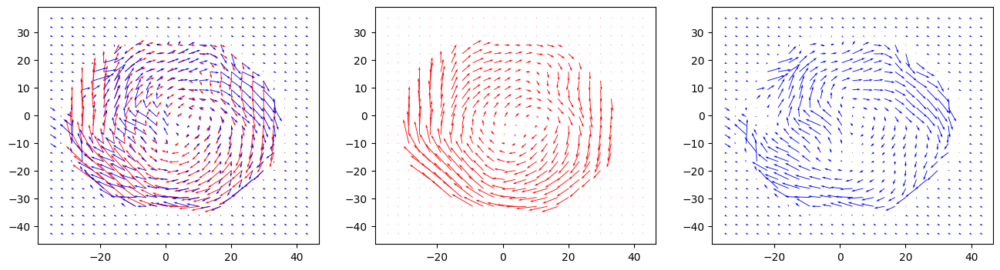

MI(average/percent):
0.7613206127379567 0.4612903225806452
SI(average/percent):
0.8406682385770615 0.7483870967741936
59


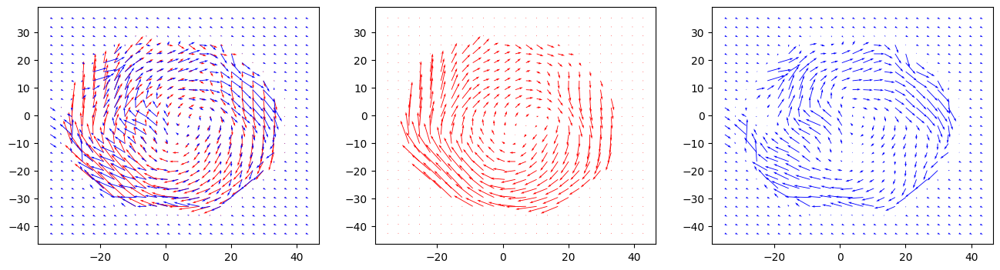

MI(average/percent):
0.7531725559997872 0.4645161290322581
SI(average/percent):
0.8540197742288234 0.7580645161290323
60


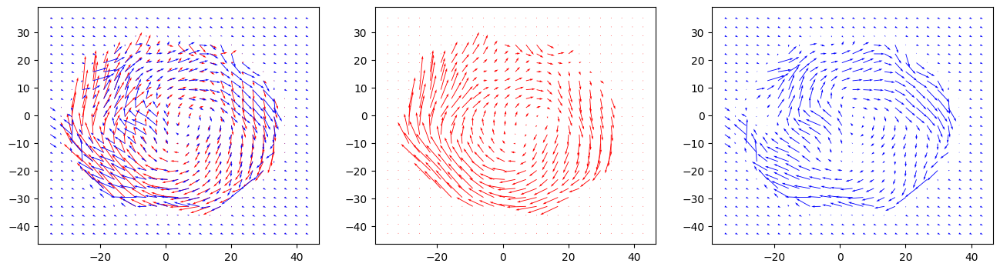

MI(average/percent):
0.7470261786960404 0.47249190938511326
SI(average/percent):
0.8546141442295404 0.7605177993527508
61


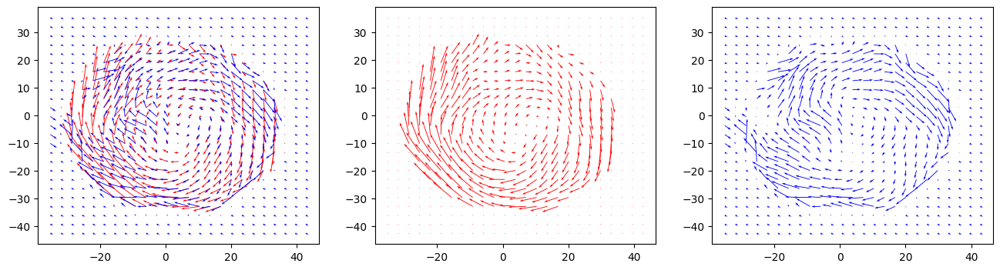

MI(average/percent):
0.7548602683863268 0.45483870967741935
SI(average/percent):
0.8520456592221802 0.7483870967741936
62


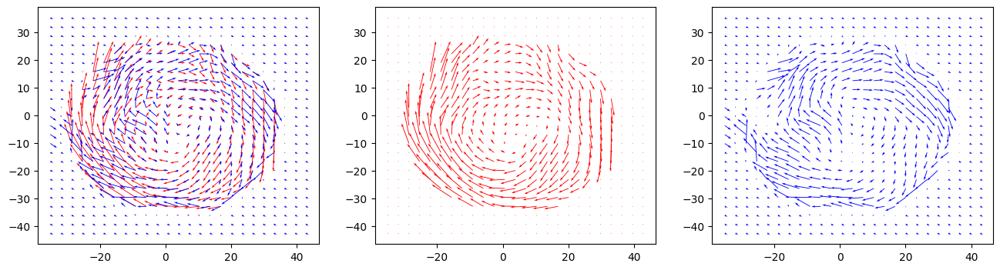

MI(average/percent):
0.7671760802442728 0.46774193548387094
SI(average/percent):
0.8396977796020698 0.7387096774193549
63


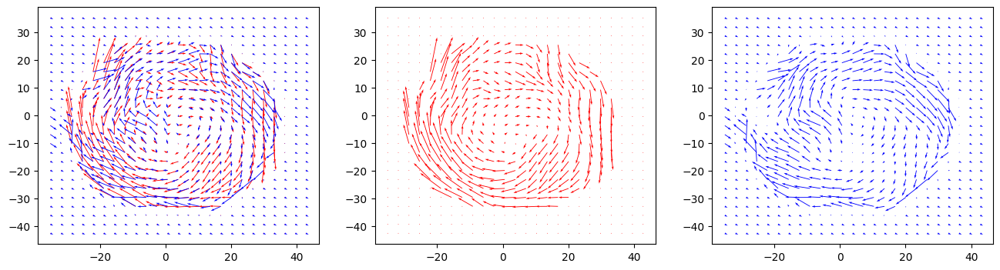

MI(average/percent):
0.7758376940202549 0.5225806451612903
SI(average/percent):
0.8235342154590803 0.7
64


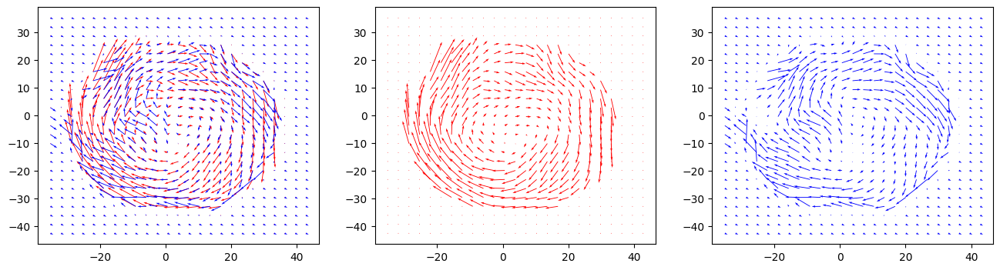

MI(average/percent):
0.7830996771355124 0.5451612903225806
SI(average/percent):
0.8385380341830521 0.7322580645161291
65


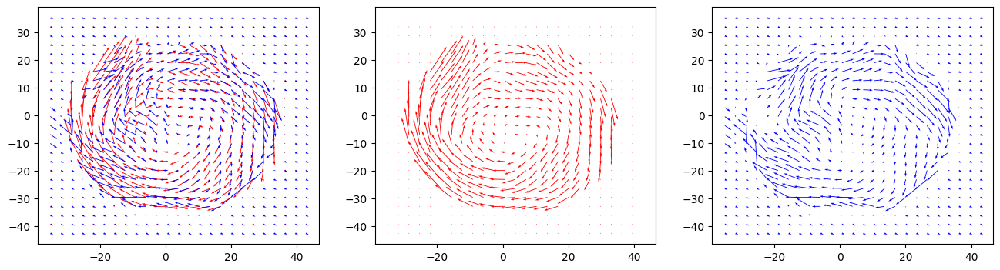

MI(average/percent):
0.7894855339647859 0.632258064516129
SI(average/percent):
0.8432468728117745 0.7645161290322581
66


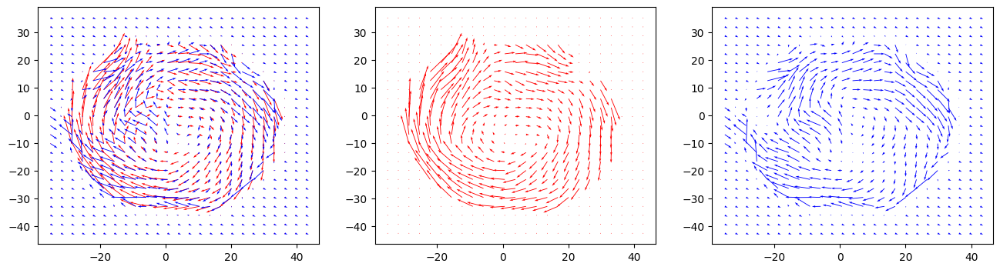

MI(average/percent):
0.7916378451911363 0.6612903225806451
SI(average/percent):
0.8344462473973764 0.7677419354838709
67


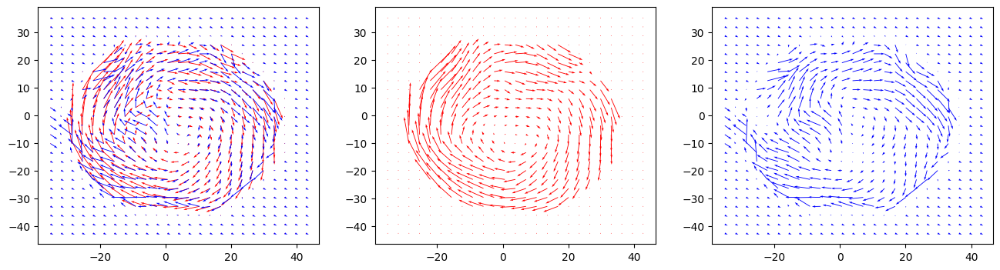

MI(average/percent):
0.7985729229721071 0.6709677419354839
SI(average/percent):
0.8516288624877636 0.7870967741935484
68


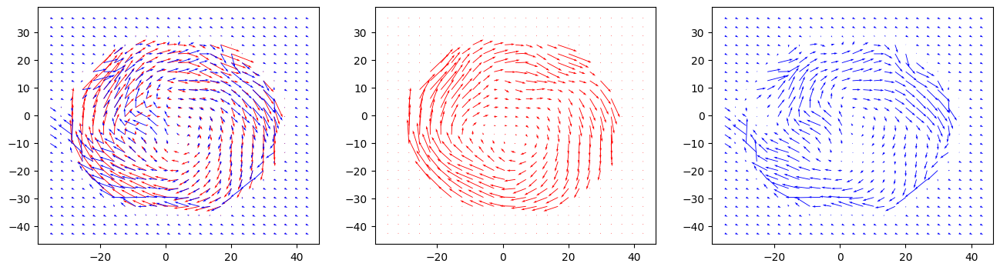

MI(average/percent):
0.7919888931405903 0.6387096774193548
SI(average/percent):
0.8657239730724843 0.7935483870967742
69


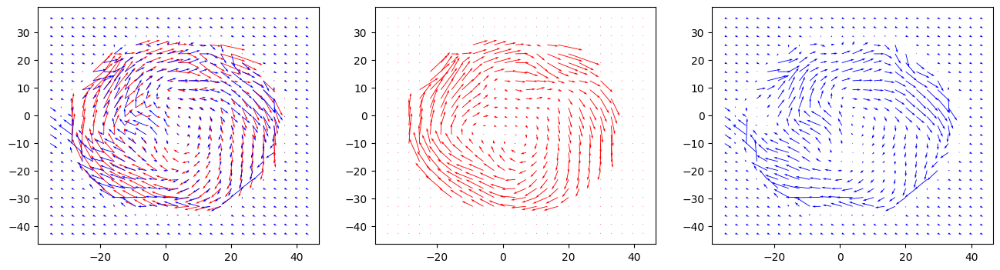

MI(average/percent):
0.7789647594789004 0.5709677419354838
SI(average/percent):
0.8721913000866162 0.8129032258064516
70


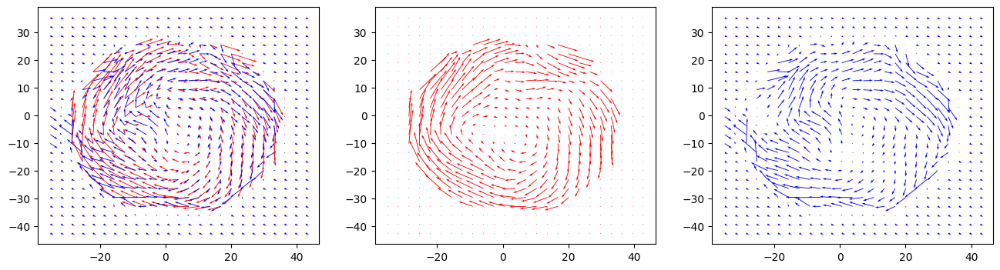

MI(average/percent):
0.7771837234388999 0.5741935483870968
SI(average/percent):
0.8688964961252571 0.8064516129032258
71


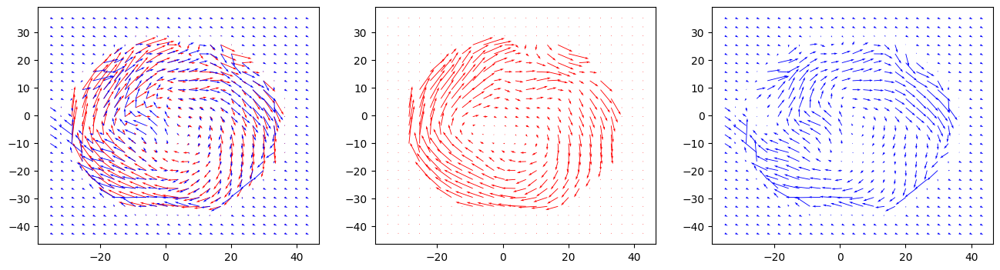

MI(average/percent):
0.7702982275420703 0.5645161290322581
SI(average/percent):
0.863113799800836 0.8161290322580645
72


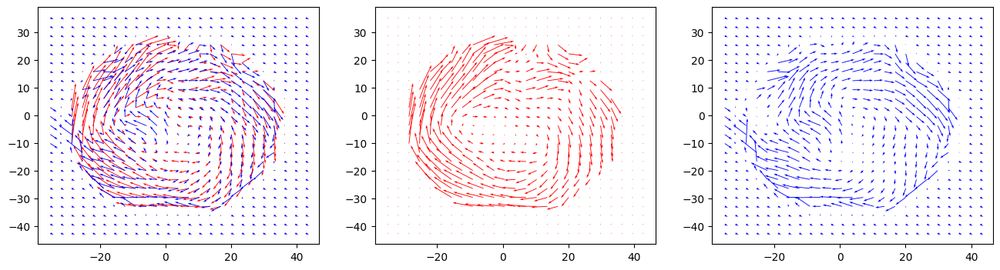

MI(average/percent):
0.7582884662805105 0.535483870967742
SI(average/percent):
0.8486205619991999 0.7935483870967742
73


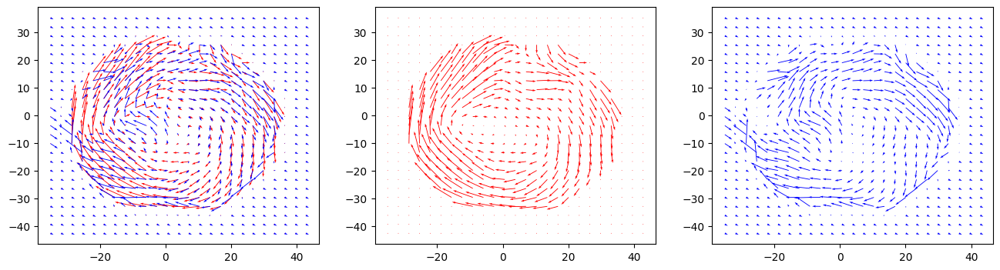

MI(average/percent):
0.767436612518538 0.5612903225806452
SI(average/percent):
0.8585863576026105 0.7838709677419354
74


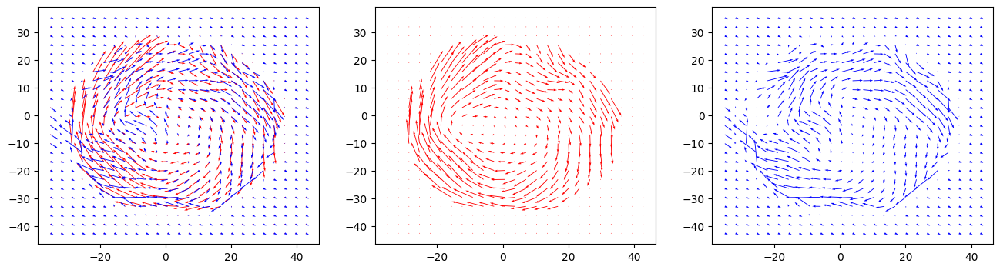

MI(average/percent):
0.7738866158905003 0.567741935483871
SI(average/percent):
0.8566402737572628 0.7709677419354839
75


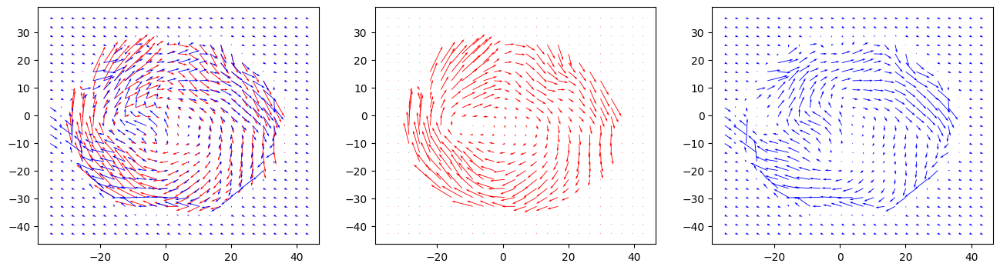

MI(average/percent):
0.7716304648413884 0.5387096774193548
SI(average/percent):
0.8383474721342656 0.7096774193548387
76


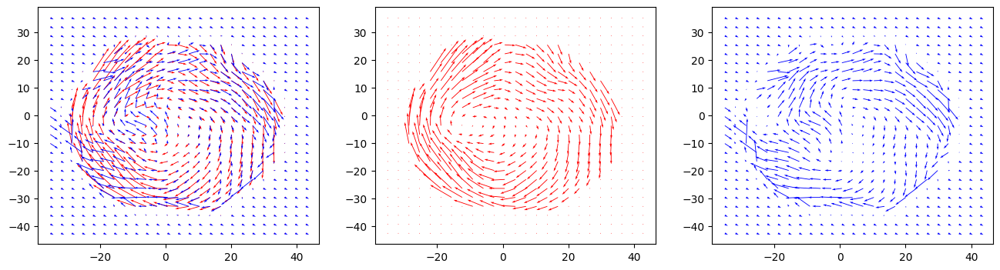

MI(average/percent):
0.7819036929826886 0.5709677419354838
SI(average/percent):
0.8546774529119815 0.7580645161290323
77


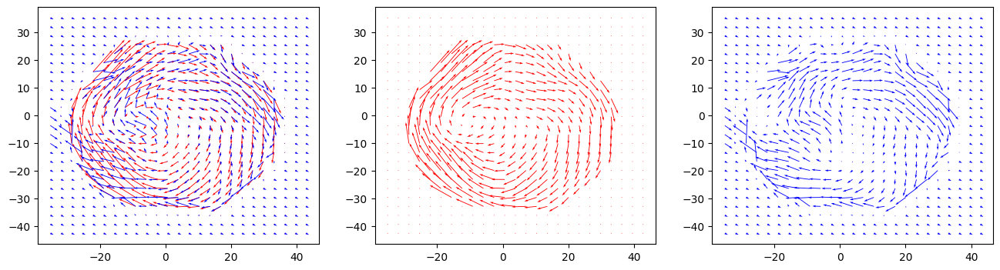

MI(average/percent):
0.7836386892022101 0.5709677419354838
SI(average/percent):
0.8648763677314649 0.7903225806451613
78


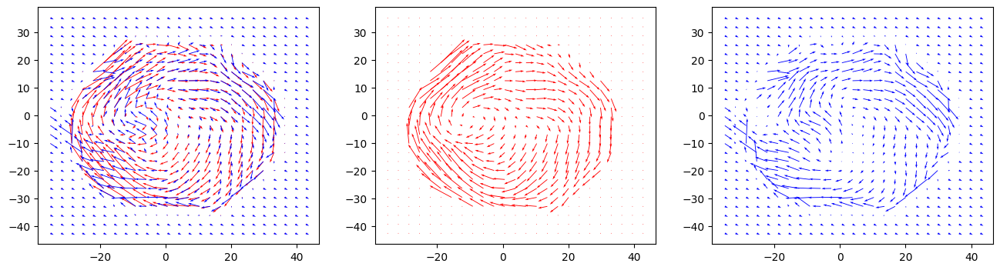

MI(average/percent):
0.7809359003924803 0.5387096774193548
SI(average/percent):
0.8631023544540347 0.8096774193548387
79


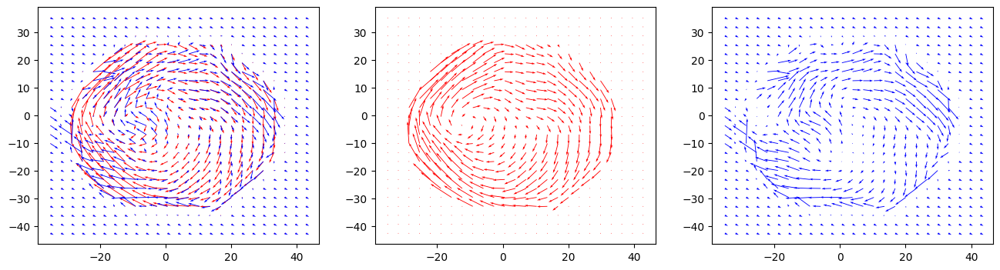

MI(average/percent):
0.7865348380333693 0.5548387096774193
SI(average/percent):
0.864074128183592 0.8129032258064516
80


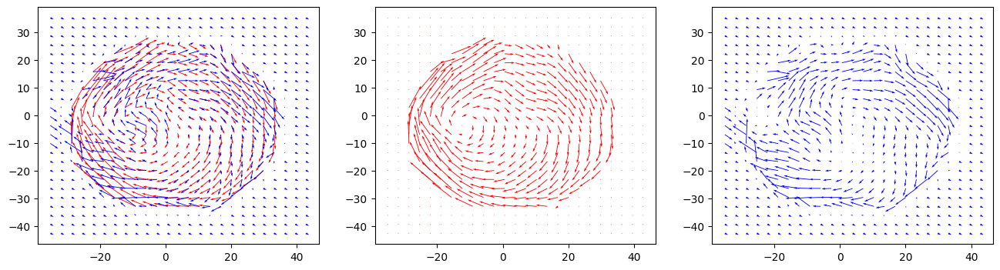

MI(average/percent):
0.7875166845166292 0.5419354838709678
SI(average/percent):
0.8542202043899649 0.7935483870967742
81


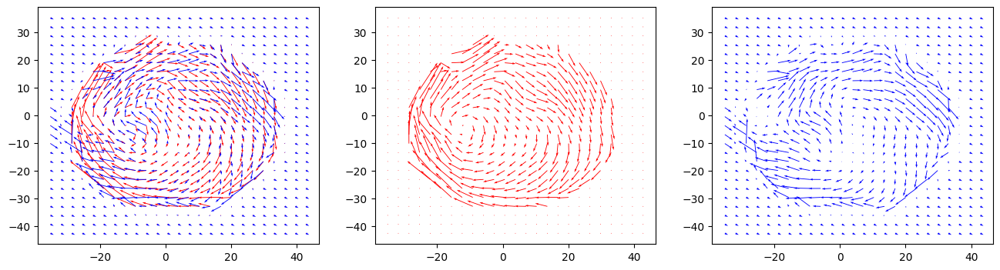

MI(average/percent):
0.7871251221627366 0.5210355987055016
SI(average/percent):
0.840121769013178 0.7313915857605178
82


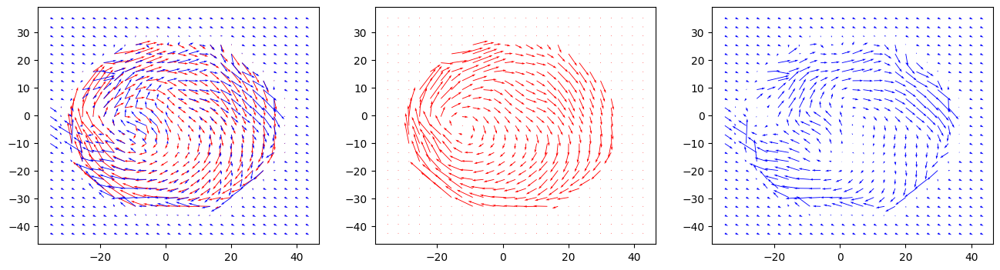

MI(average/percent):
0.7842522367520437 0.5419354838709678
SI(average/percent):
0.8502247025428702 0.7838709677419354
83


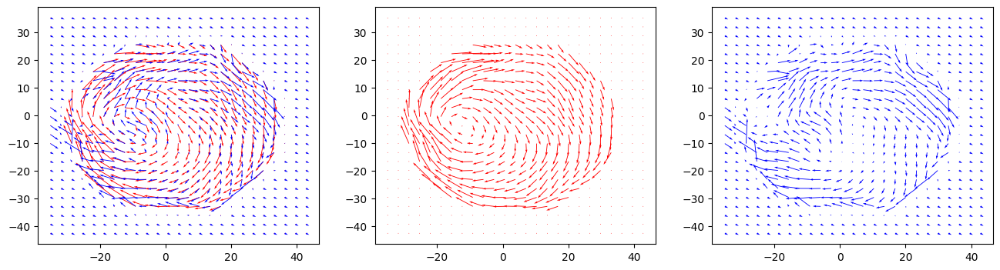

MI(average/percent):
0.7778343177710302 0.5516129032258065
SI(average/percent):
0.8566333090468009 0.7967741935483871
84


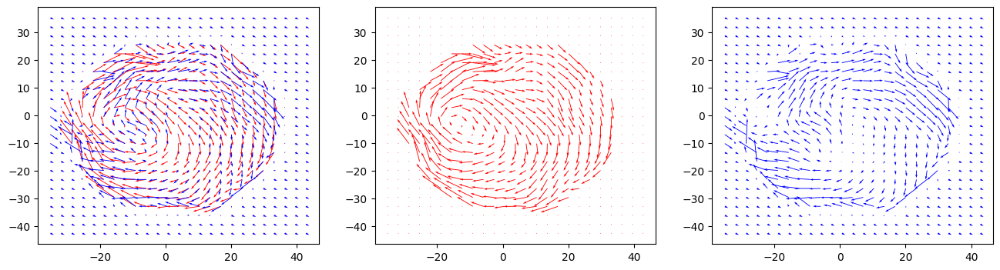

MI(average/percent):
0.7666256548120461 0.5129032258064516
SI(average/percent):
0.855088871491857 0.7870967741935484
85


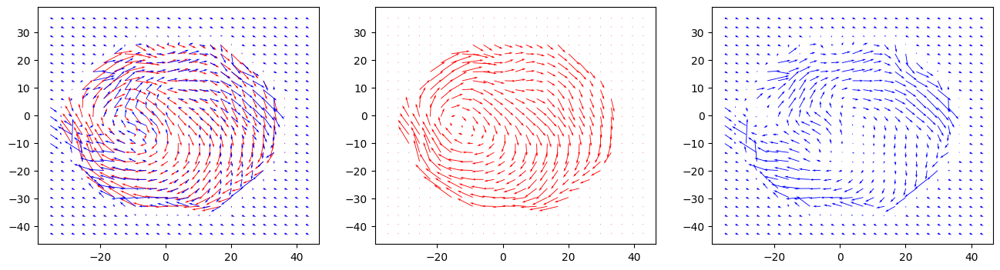

MI(average/percent):
0.7710622893886293 0.5064516129032258
SI(average/percent):
0.8560896231860592 0.7967741935483871
86


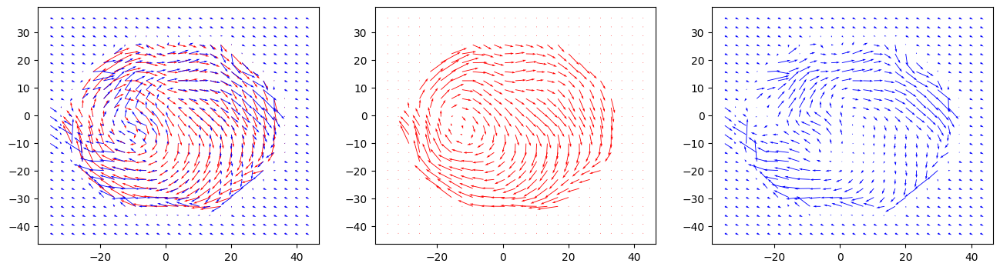

MI(average/percent):
0.7704746166819675 0.5
SI(average/percent):
0.8488375130861276 0.7870967741935484
87


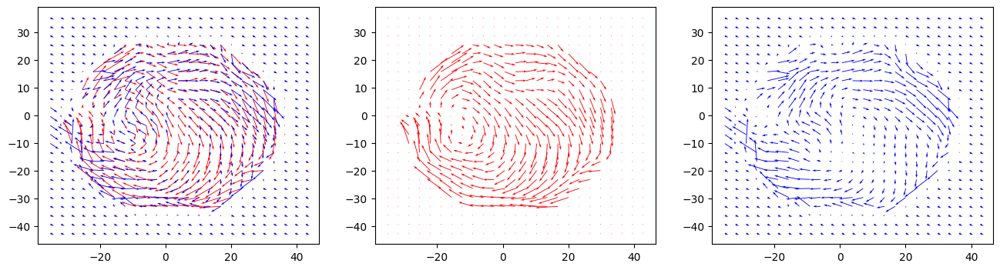

MI(average/percent):
0.7634524498028572 0.4774193548387097
SI(average/percent):
0.8268310171286521 0.7451612903225806
88


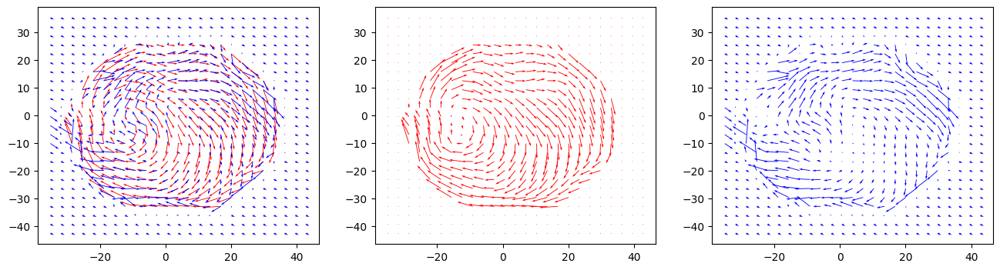

MI(average/percent):
0.7669987992189126 0.4806451612903226
SI(average/percent):
0.8392258273506809 0.7451612903225806
89


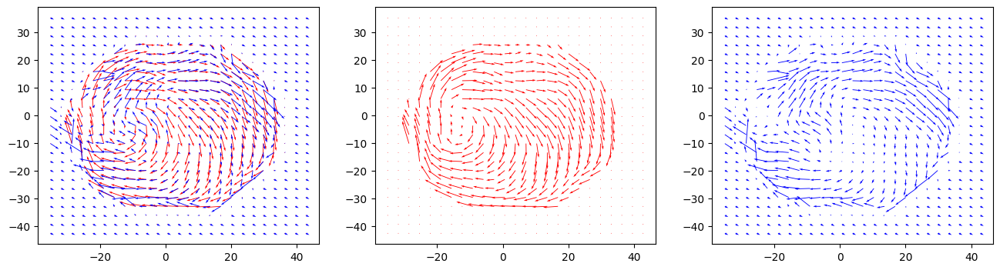

MI(average/percent):
0.7629691636294217 0.4645161290322581
SI(average/percent):
0.8468609632246699 0.7612903225806451
90


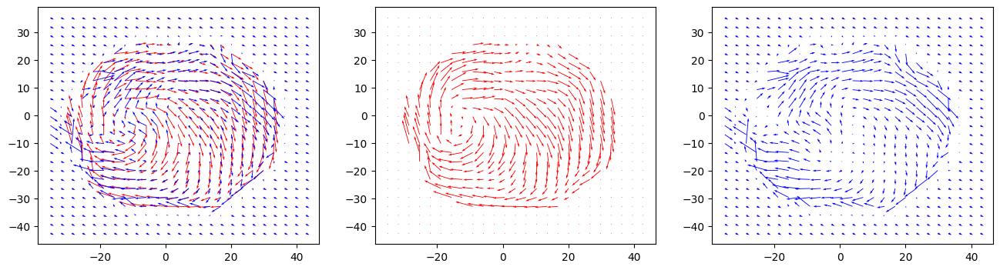

MI(average/percent):
0.749340067037638 0.44193548387096776
SI(average/percent):
0.8492789839089966 0.7516129032258064
91


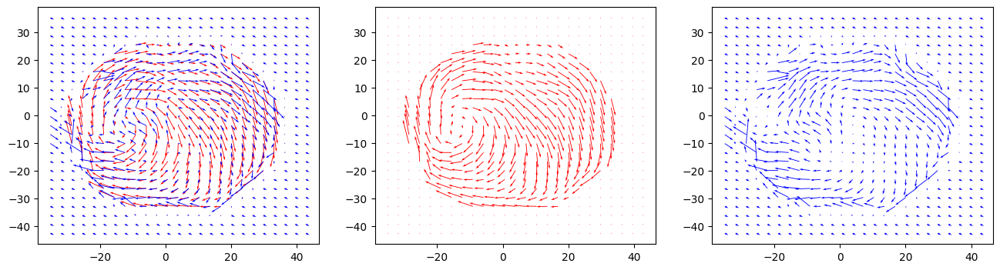

MI(average/percent):
0.7427609623779156 0.3903225806451613
SI(average/percent):
0.8415572251927097 0.7645161290322581
92


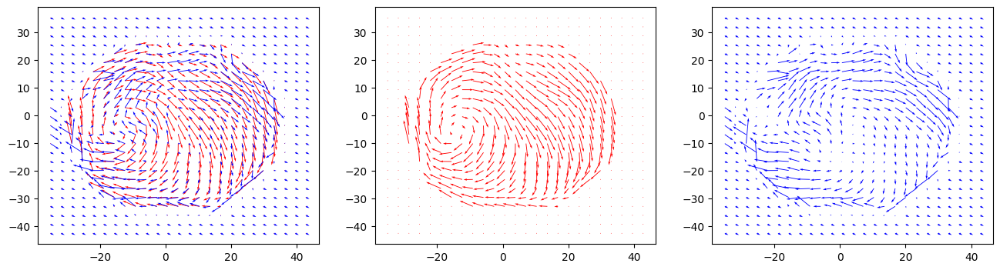

MI(average/percent):
0.7348605331314789 0.3774193548387097
SI(average/percent):
0.8272280387825245 0.7354838709677419
93


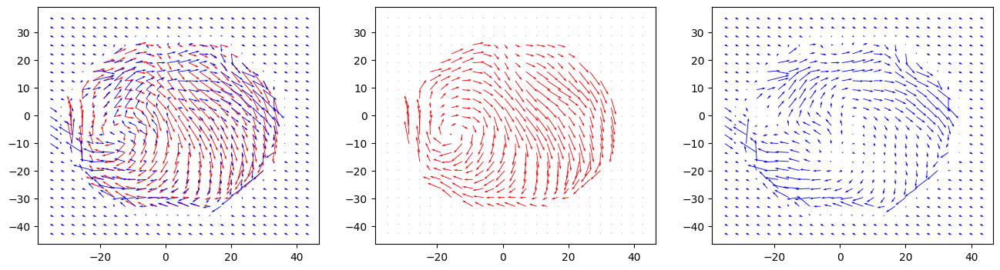

MI(average/percent):
0.727367811660369 0.37216828478964403
SI(average/percent):
0.8122648614708504 0.6893203883495146
94


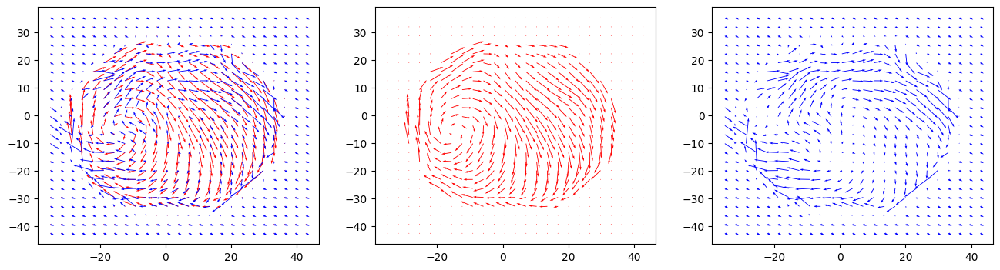

MI(average/percent):
0.7354115557438533 0.3903225806451613
SI(average/percent):
0.8164822228768548 0.7096774193548387
95


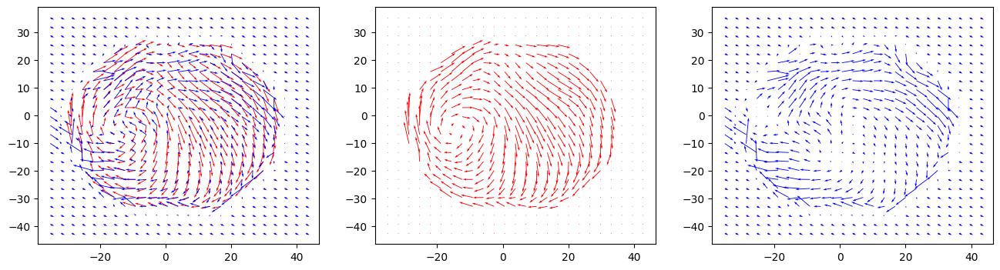

MI(average/percent):
0.7416656115873724 0.4161290322580645
SI(average/percent):
0.8156560643808556 0.7096774193548387
96


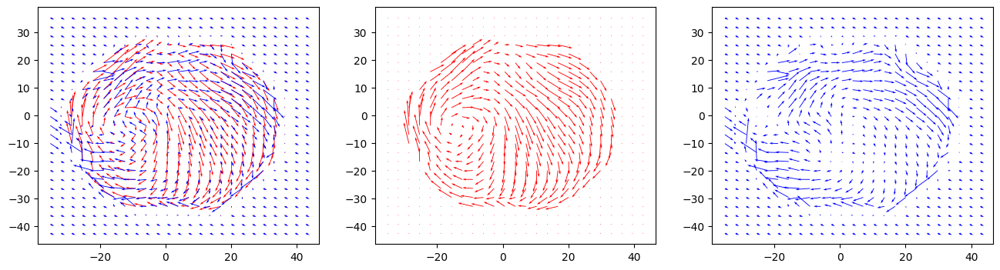

MI(average/percent):
0.7426814723966716 0.4258064516129032
SI(average/percent):
0.8115562645574401 0.7129032258064516
97


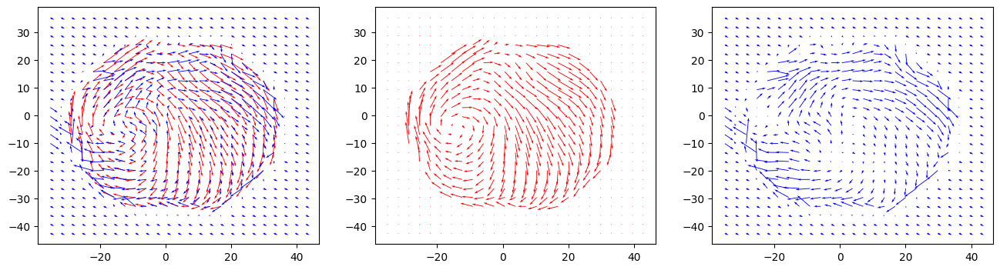

MI(average/percent):
0.7444441912728404 0.4161290322580645
SI(average/percent):
0.8155580285435404 0.7096774193548387
98


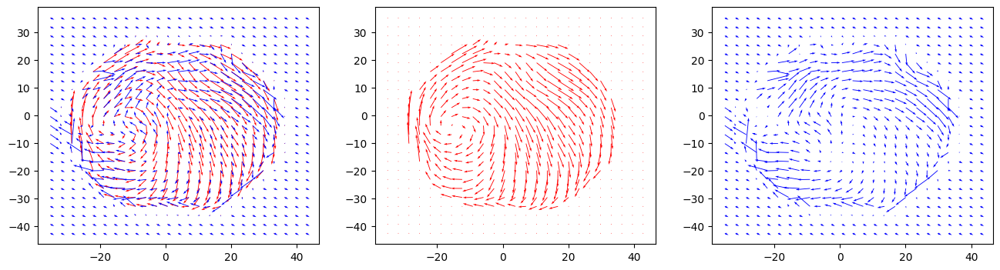

MI(average/percent):
0.7426142922917883 0.42258064516129035
SI(average/percent):
0.8163494662632366 0.7
99


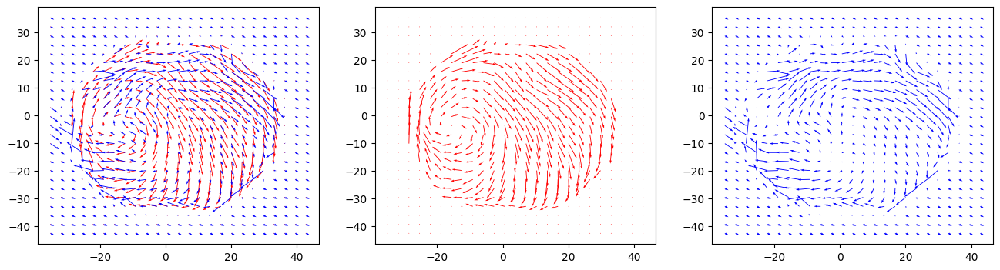

MI(average/percent):
0.7393395459960799 0.43870967741935485
SI(average/percent):
0.8137263109408003 0.6967741935483871
100


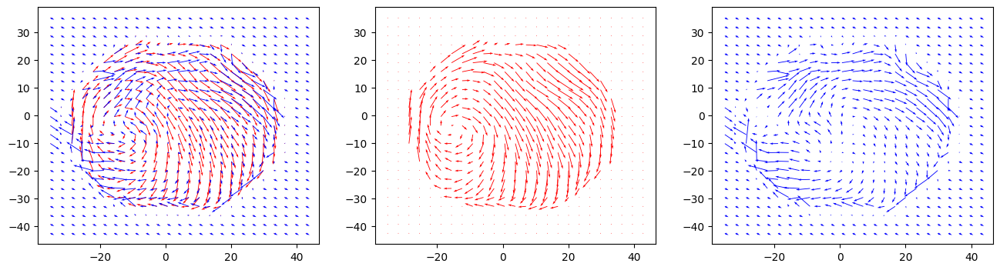

MI(average/percent):
0.7325649890173345 0.42258064516129035
SI(average/percent):
0.8066021650383065 0.6838709677419355
101


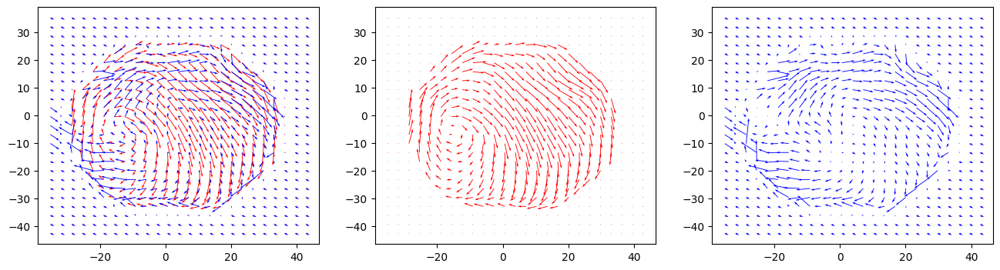

MI(average/percent):
0.7235628025967474 0.42258064516129035
SI(average/percent):
0.7926489606059338 0.667741935483871
102


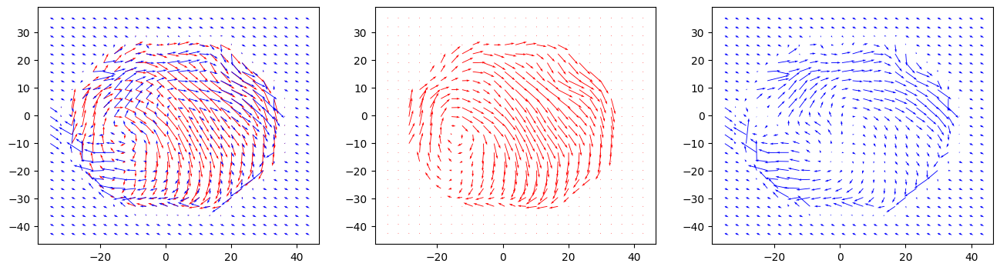

MI(average/percent):
0.7156233580789536 0.432258064516129
SI(average/percent):
0.7703841682866723 0.6290322580645161
103


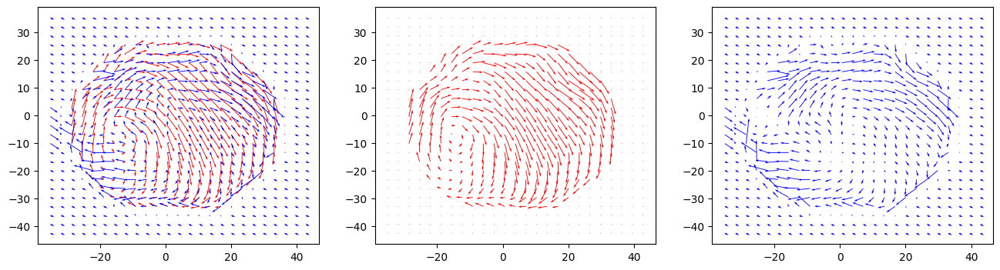

MI(average/percent):
0.7196904936008293 0.45806451612903226
SI(average/percent):
0.7753108605593325 0.632258064516129
104


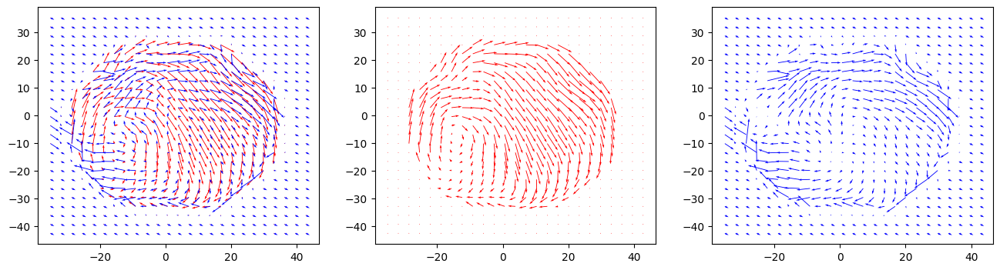

MI(average/percent):
0.7201872590497378 0.46774193548387094
SI(average/percent):
0.7781371523579131 0.6451612903225806
105


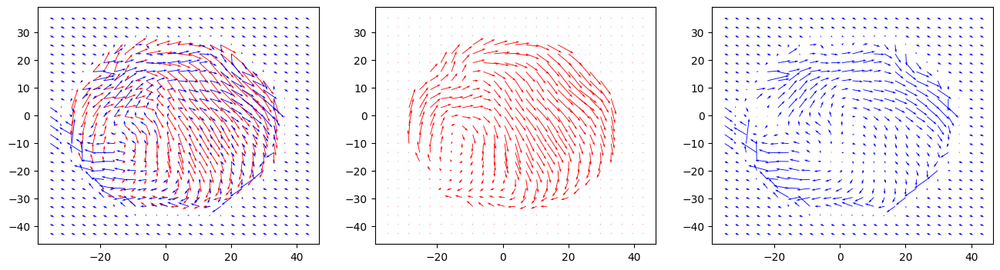

MI(average/percent):
0.7221551023774534 0.4692556634304207
SI(average/percent):
0.7777580639818801 0.6440129449838188
106


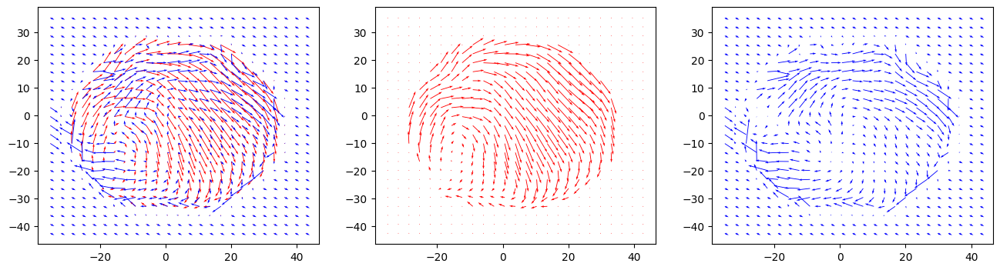

MI(average/percent):
0.7202548447920198 0.46601941747572817
SI(average/percent):
0.7797376457018572 0.6504854368932039
107


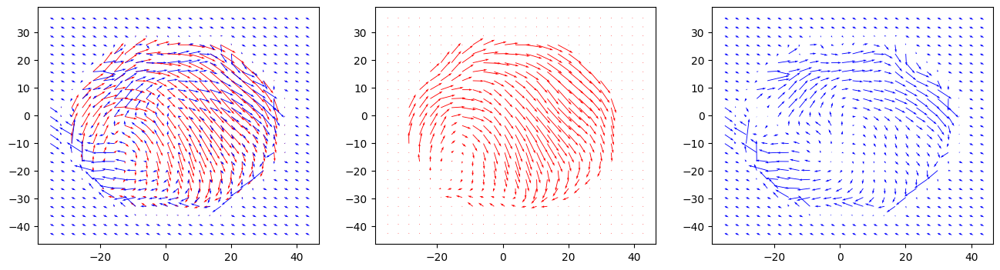

MI(average/percent):
0.7183615793724256 0.4854368932038835
SI(average/percent):
0.7782150882034736 0.6731391585760518
108


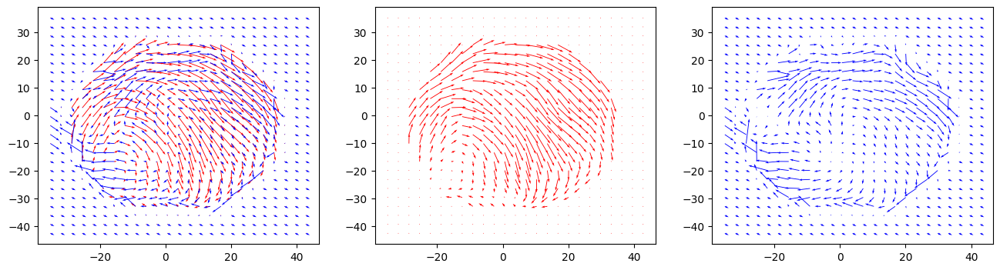

MI(average/percent):
0.7159816600860764 0.48220064724919093
SI(average/percent):
0.7779354814688714 0.6796116504854369
109


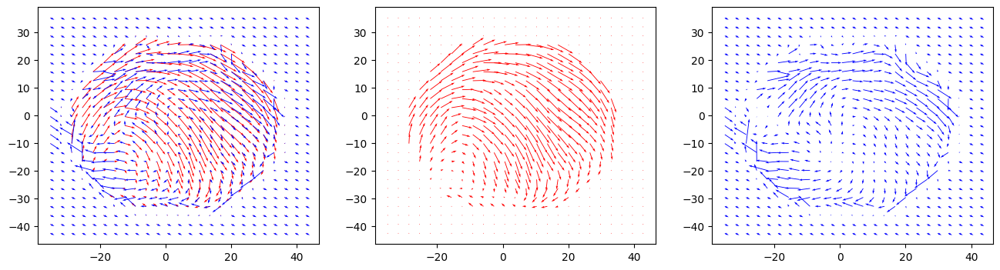

MI(average/percent):
0.7136112626633757 0.46774193548387094
SI(average/percent):
0.8007849213661585 0.7258064516129032
110


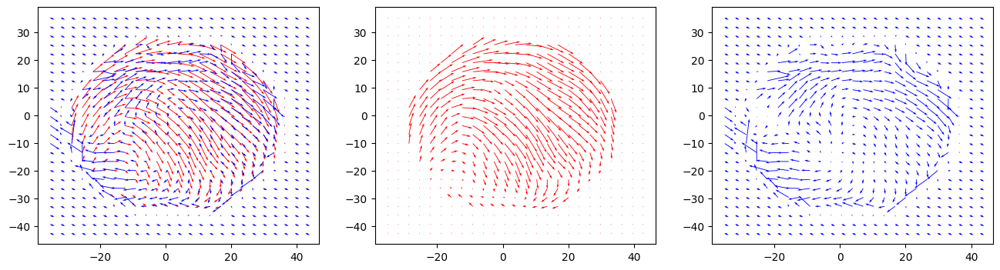

MI(average/percent):
0.7134766581862768 0.43870967741935485
SI(average/percent):
0.8198025556654994 0.7354838709677419
111


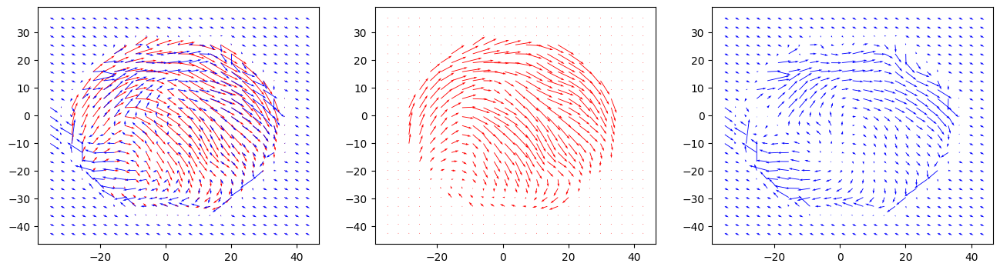

MI(average/percent):
0.7142130423826237 0.43870967741935485
SI(average/percent):
0.8236719481372451 0.7258064516129032
112


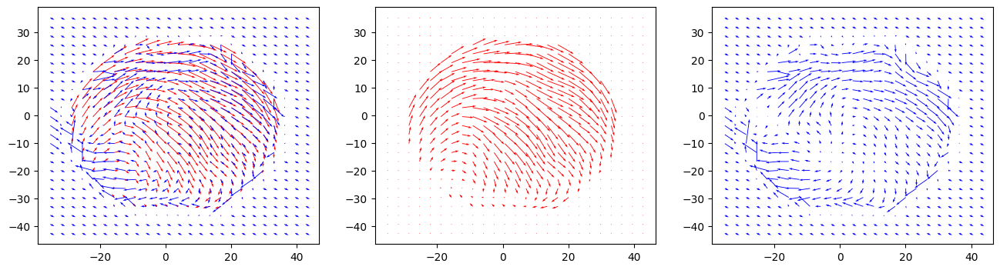

MI(average/percent):
0.7174641302324968 0.49032258064516127
SI(average/percent):
0.8272199350718527 0.7483870967741936
113


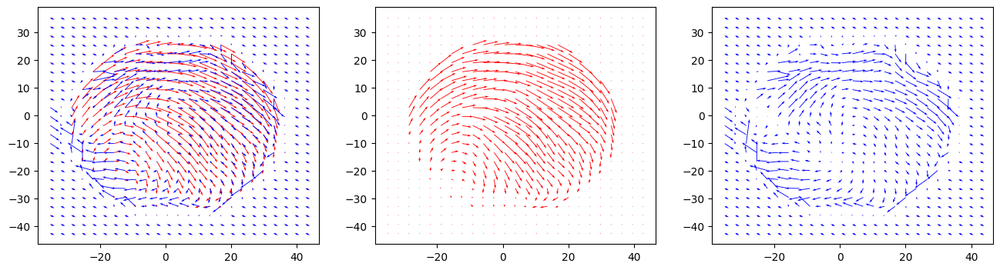

MI(average/percent):
0.7199890016218511 0.5096774193548387
SI(average/percent):
0.826880635665272 0.7516129032258064
114


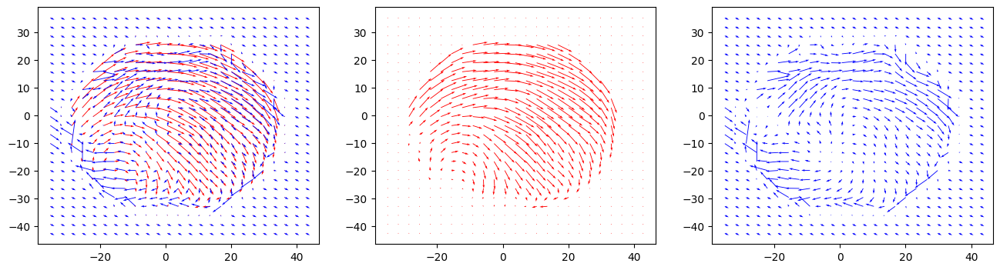

MI(average/percent):
0.7253994545913337 0.5145631067961165
SI(average/percent):
0.822370240299205 0.7411003236245954
115


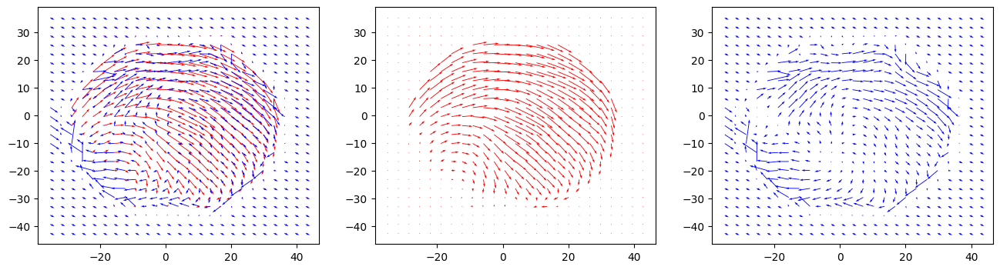

MI(average/percent):
0.7131988346724225 0.5032258064516129
SI(average/percent):
0.823250445488123 0.7419354838709677
116


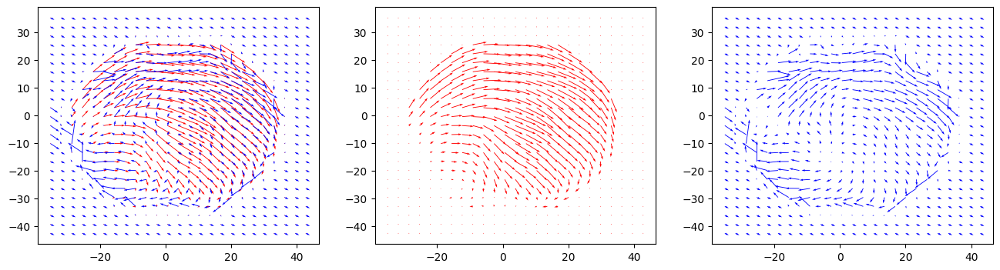

MI(average/percent):
0.7053752304357727 0.47419354838709676
SI(average/percent):
0.8233953205024902 0.7387096774193549
117


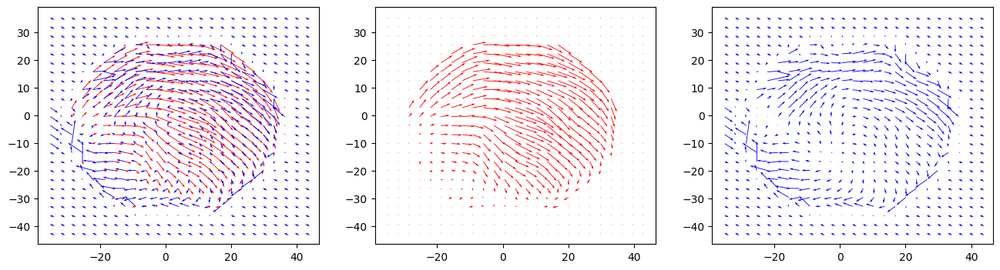

MI(average/percent):
0.7006994854056742 0.45806451612903226
SI(average/percent):
0.8282490874897595 0.7483870967741936


In [11]:
for i in range(p_tot):
    print(i)
    j=i
    plt.figure(figsize=(16, 4))
    plt.subplot(1, 3, 1)
    plt.quiver(spatial_grid[:,:,0],spatial_grid[:,:,1],v_train[:,:,j,0],v_train[:,:,j,1],color='r')
    plt.quiver(spatial_grid[:,:,0],spatial_grid[:,:,1],pltpredict[:,:,j,0],pltpredict[:,:,j,1],color='b')
    plt.subplot(1, 3, 2)
    plt.quiver(spatial_grid[:,:,0],spatial_grid[:,:,1],v_train[:,:,j,0],v_train[:,:,j,1],color='r')
    #plt.quiver(spatial_grid[:,:,1],spatial_grid[:,:,0],pltpredict[:,:,i,0],pltpredict[:,:,i,1],color='b')
    plt.subplot(1, 3, 3)
    #plt.quiver(spatial_grid[:,:,1],spatial_grid[:,:,0],u_dot_train[:,:,i+1,0],u_dot_train[:,:,i+1,1],color='r')
    plt.quiver(spatial_grid[:,:,0],spatial_grid[:,:,1],pltpredict[:,:,j,0],pltpredict[:,:,j,1],color='b')
    plt.show()
    mi_t[i],mi_t_per[i]=miscore(pltpredict[:,:,j,],v_train[:,:,j,:])
    si_t[i],si_t_per[i]=siscore(pltpredict[:,:,j,],v_train[:,:,j,:])

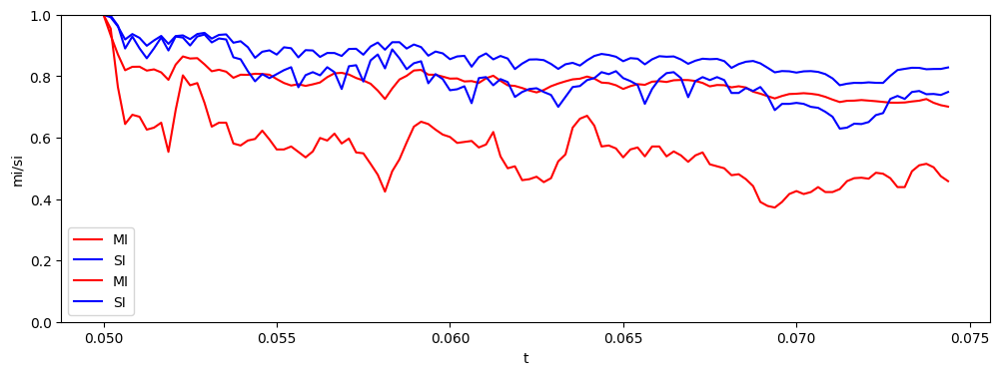

In [12]:
plt.figure(figsize=(12, 4))
plt.ylim(0,1)
plt.xlabel('t')
plt.ylabel('mi/si')
plt.plot(t_train,mi_t,'r',label='MI')
plt.plot(t_train,si_t,'b',label='SI')
plt.plot(t_train,mi_t_per,'r',label='MI')
plt.plot(t_train,si_t_per,'b',label='SI')
plt.legend()
plt.plot
plt.show()